In [2]:
import pandas as pd
from preprocessing import TextPreprocessor
from topicmodels import Modeling

In [3]:
data = pd.read_csv('data/txt_and_genres.csv')

In [4]:
data.drop(columns=['Unnamed: 0'], inplace=True)

In [4]:
data

,title,text,genre,genre_amount
0,Domino,b'D O M I N O\r\n...,"['Thriller', 'Action', 'Crime']",3
1,Knocked Up,b'KNOCKED UP\r\n\r\nWritten by\r\n\r\nJudd Apa...,"['Comedy', 'Romance', 'Drama']",3
2,10 Things I Hate About You,b'TEN THINGS I HATE ABOUT YOU\r\n\r\nwritten b...,"['Comedy', 'Romance', 'Drama']",3
3,10000 B C,"b""10,000 B.C.\r\nby\r\nRoland Emmerich & Haral...","['Adventure', 'Action', 'Drama', 'Fantasy']",4
4,12 And Holding,b'12 AND HOLDING\r\n\r\nWritten by\r\n\r\nAnth...,['Drama'],1
...,...,...,...,...
2120,Zodiac,b'CHRONICLES\r\nby\r\nJamie Vanderbilt\r\n\r\n...,"['Crime', 'Drama', 'Mystery', 'Thriller']",4
2121,Zombieland,b'\xef\x81\x9a\xef\x81\x8f\xef\x81\x8d\xef\x81...,"['Comedy', 'Horror']",2
2122,Zookeeper,"b""The Zoo Keeper\r\nby\r\nJay Scherick & David...","['Comedy', 'Romance', 'Family']",3
2123,Zootopia,"b""ZOOTOPIA\r\n\r\nOriginal Screenplay by\r\nJa...","['Animation', 'Adventure', 'Family', 'Comedy']",4


In [163]:
df = pd.read_csv('genre_label.txt', delimiter='-')


def row_destroyer(row):
    t = []
    for i in row.split():
        t.append(i.strip(','))

    return t

df['genre'] = df.genres.apply(lambda x: row_destroyer(x))

df['title'] = df.title.str.strip(' ')
type(df.genre[0])

list

In [5]:
data['genre'] = data.genre.str.replace(']', '').str.strip('[').str.replace(',', '').str.split()

C:\Users\mikey\AppData\Local\Temp\ipykernel_25176\1755058337.py:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  data['genre'] = data.genre.str.replace(']', '').str.strip('[').str.replace(',', '').str.split()


In [8]:
def lst_breaker(row):
    lst = []
    for i in row:
        lst.append(i.strip("'"))
    
    if 'Science' in lst:
        idx = lst.index('Science')
        lst.insert(idx, 'SciFi')
        lst.remove('Science')
        lst.remove('Fiction')

    return lst

In [10]:
data['genre'] = data.genre.apply(lambda x: lst_breaker(x))

In [12]:
data

,title,text,genre,genre_amount
0,Domino,b'D O M I N O\r\n...,"[Thriller, Action, Crime]",3
1,Knocked Up,b'KNOCKED UP\r\n\r\nWritten by\r\n\r\nJudd Apa...,"[Comedy, Romance, Drama]",3
2,10 Things I Hate About You,b'TEN THINGS I HATE ABOUT YOU\r\n\r\nwritten b...,"[Comedy, Romance, Drama]",3
3,10000 B C,"b""10,000 B.C.\r\nby\r\nRoland Emmerich & Haral...","[Adventure, Action, Drama, Fantasy]",4
4,12 And Holding,b'12 AND HOLDING\r\n\r\nWritten by\r\n\r\nAnth...,[Drama],1
...,...,...,...,...
2120,Zodiac,b'CHRONICLES\r\nby\r\nJamie Vanderbilt\r\n\r\n...,"[Crime, Drama, Mystery, Thriller]",4
2121,Zombieland,b'\xef\x81\x9a\xef\x81\x8f\xef\x81\x8d\xef\x81...,"[Comedy, Horror]",2
2122,Zookeeper,"b""The Zoo Keeper\r\nby\r\nJay Scherick & David...","[Comedy, Romance, Family]",3
2123,Zootopia,"b""ZOOTOPIA\r\n\r\nOriginal Screenplay by\r\nJa...","[Animation, Adventure, Family, Comedy]",4


In [82]:
def first_genre(row):

    if row[0] == 'Drama':
        return 0
    elif row[0] == 'Comedy':
        return 1
    elif row[0] == 'Action':
        return 2
    elif row[0] == 'Horror':
        return 3
    elif row[0] == 'Adventure':
        return 4
    elif row[0] == 'Crime':
        return 5
    elif row[0] == 'Thriller':
        return 6
    elif row[0] == 'SciFi':
        return 7
    elif row[0] == 'Romance':
        return 8
    elif row[0] == 'Animation':
        return 9
    elif row[0] == 'Documentary':
        return 10
    elif row[0] == 'Fantasy':
        return 11
    elif row[0] == 'Mystery':
        return 12
    elif row[0] == 'Family':
        return 13
    elif row[0] == 'War':
        return 14
    elif row[0] == 'History':
        return 15
    elif row[0] == 'Music':
        return 16
    elif row[0] == 'Western':
        return 17
    else:
        return 18

In [13]:
good_data = data[data.genre_amount > 0]

In [83]:
good_data['target'] = good_data.genre.apply(lambda x: first_genre(x))
good_data.drop(good_data[good_data.target == 18].index, inplace=True)

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)
C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [191]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [192]:
X = good_data.loc[:, ['text', 'title']].copy()
y = good_data.target

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

In [193]:
tp = TextPreprocessor(activator_type='wb', lem_or_stem='lem')

In [194]:
X_train_lems = tp.fit_transform(X_train.text)

In [196]:
pipe = Pipeline([('cv', CountVectorizer(min_df= 0.5, max_df=0.95)), ('nb', MultinomialNB(alpha=5))])

In [195]:
X_train.to_csv('data/training_set.csv')
X_test.to_csv('data/testing_set.csv')
y_train.to_csv('data/training_targets.csv')
y_test.to_csv('data/testing_targets.csv')

In [197]:
pipe.fit(X_train_lems, y_train)

Pipeline(steps=[('cv', CountVectorizer(max_df=0.95, min_df=0.5)),
                ('nb', MultinomialNB(alpha=5))])

In [198]:
from sklearn.metrics import plot_confusion_matrix

In [202]:
X_test_lems = tp.transform(X_test.text)

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


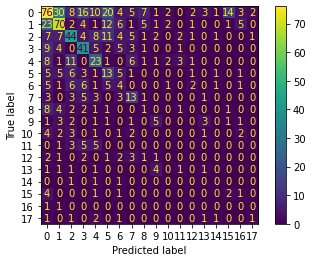

In [203]:
plot_confusion_matrix(pipe, X_test_lems, y_test)

In [206]:
from sklearn.metrics import classification_report

print(classification_report(y_test, pipe.predict(X_test_lems)))

              precision    recall  f1-score   support

           0       0.48      0.37      0.42       204
           1       0.53      0.52      0.53       134
           2       0.47      0.45      0.46        98
           3       0.47      0.58      0.52        71
           4       0.35      0.40      0.37        58
           5       0.19      0.31      0.24        42
           6       0.11      0.12      0.11        33
           7       0.33      0.41      0.36        32
           8       0.06      0.05      0.05        21
           9       0.33      0.26      0.29        19
          10       0.00      0.00      0.00        16
          11       0.00      0.00      0.00        14
          12       0.00      0.00      0.00        13
          13       0.10      0.10      0.10        10
          14       0.00      0.00      0.00         3
          15       0.11      0.22      0.14         9
          16       0.00      0.00      0.00         2
          17       0.25    

In [207]:
good_data

,title,text,genre,genre_amount,target
0,Domino,b'D O M I N O\r\n...,"[Thriller, Action, Crime]",3,6
1,Knocked Up,b'KNOCKED UP\r\n\r\nWritten by\r\n\r\nJudd Apa...,"[Comedy, Romance, Drama]",3,1
2,10 Things I Hate About You,b'TEN THINGS I HATE ABOUT YOU\r\n\r\nwritten b...,"[Comedy, Romance, Drama]",3,1
3,10000 B C,"b""10,000 B.C.\r\nby\r\nRoland Emmerich & Haral...","[Adventure, Action, Drama, Fantasy]",4,4
4,12 And Holding,b'12 AND HOLDING\r\n\r\nWritten by\r\n\r\nAnth...,[Drama],1,0
...,...,...,...,...,...
2120,Zodiac,b'CHRONICLES\r\nby\r\nJamie Vanderbilt\r\n\r\n...,"[Crime, Drama, Mystery, Thriller]",4,5
2121,Zombieland,b'\xef\x81\x9a\xef\x81\x8f\xef\x81\x8d\xef\x81...,"[Comedy, Horror]",2,1
2122,Zookeeper,"b""The Zoo Keeper\r\nby\r\nJay Scherick & David...","[Comedy, Romance, Family]",3,1
2123,Zootopia,"b""ZOOTOPIA\r\n\r\nOriginal Screenplay by\r\nJa...","[Animation, Adventure, Family, Comedy]",4,9


In [14]:
def genre_check(row, genre):
    if genre in row:
        return 1
    else:
        return 0

In [15]:
genre_check(good_data.genre[0], 'Comedy')

0

In [16]:
genre_lst = []

for i in good_data.genre:
    for x in i:
        genre_lst.append(x)

genre_lst = list(set(genre_lst))
genre_lst

['Music',
 'Movie',
 'TV',
 'Fantasy',
 'Mystery',
 'Animation',
 'Western',
 'History',
 'Family',
 'Crime',
 'Romance',
 'Thriller',
 'Comedy',
 'Action',
 'War',
 'Drama',
 'SciFi',
 'Horror',
 'Documentary',
 'Adventure']

In [17]:
for i in genre_lst:
    good_data[i] = good_data.genre.apply(lambda x: genre_check(x, i))

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


In [18]:
sums = []
for i in genre_lst:
    total = good_data[i].sum()
    sums.append(total)


In [19]:
import matplotlib.pyplot as plt

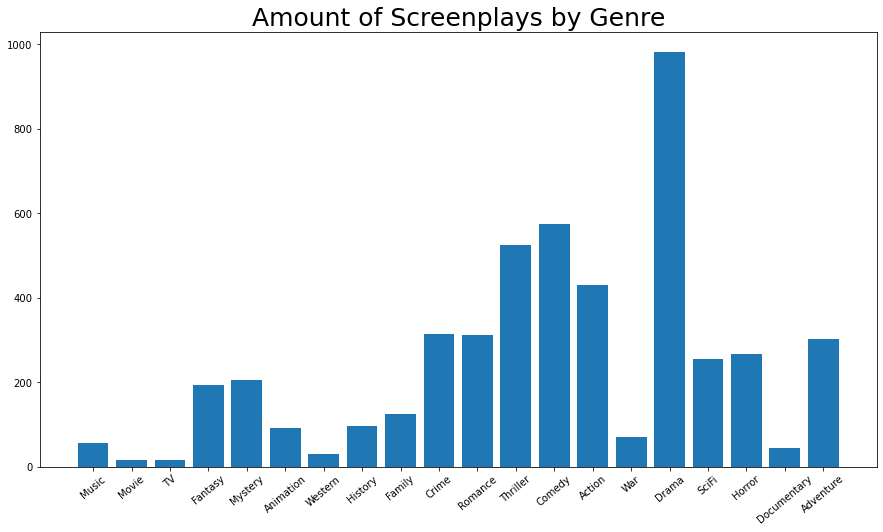

In [20]:
fig, ax = plt.subplots(figsize=(15,8))

ax.bar(list(range(len(genre_lst))), sums)
ax.set_xticks(list(range(len(genre_lst))))
ax.set_xticklabels(genre_lst, rotation=40)
ax.set_title('Amount of Screenplays by Genre', size=25)

plt.show()

In [21]:
good_data.drop(columns=['TV'], inplace=True)
genre_lst.remove('TV')

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [22]:
good_data.drop(columns=['Movie'], inplace=True)
genre_lst.remove('Movie')

<AxesSubplot:ylabel='genre_amount'>

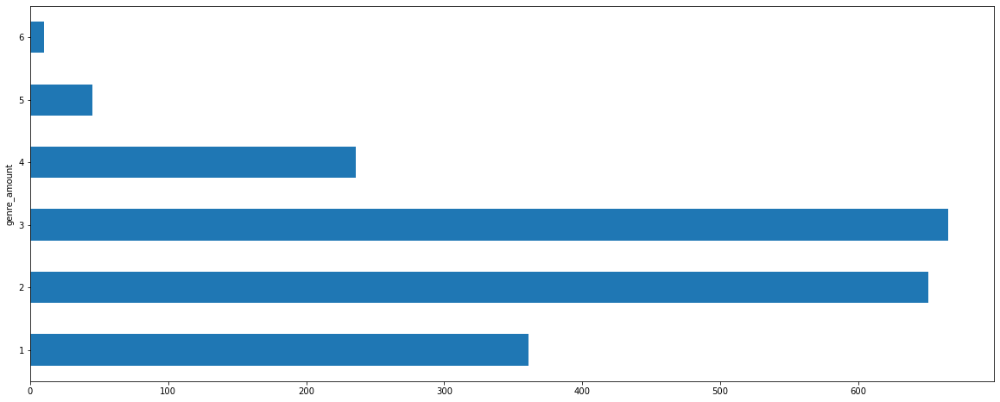

In [24]:
good_data.groupby(['genre_amount'])['title'].count().plot(kind='barh', figsize=(20,8))

In [25]:
def the_cleaner(text):

    new_text = text.replace('\\r', ' ').replace('\\n', ' ').replace('\\', '').split()
    lst = [re.sub(r"\([^()]*\)", "", i) for i in new_text]
    perfect = [x for x in lst if x.isalpha() and len(x) > 1]

    return " ".join(perfect)
    
    

In [27]:
import re
good_data['clean'] = good_data.text.apply(lambda x: the_cleaner(x))

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


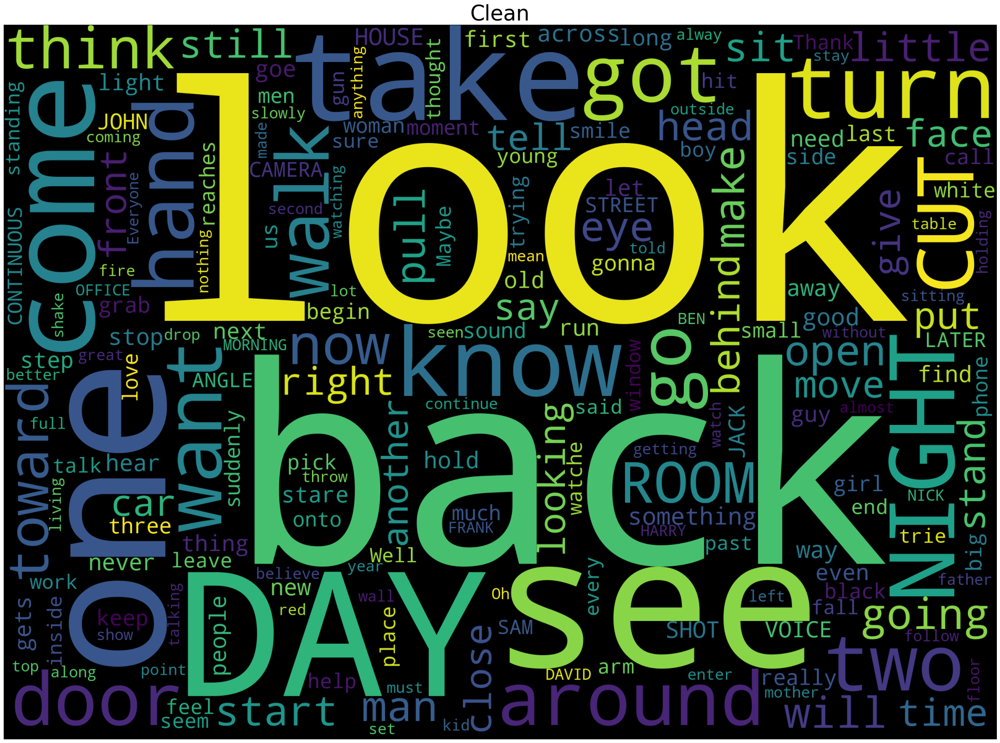

In [319]:
plt.figure(figsize=(40,25))
# clean
subset = good_data.clean
cloud_toxic = WordCloud(
                          stopwords=STOPWORDS,
                          background_color='black',
                          collocations=False,
                          width=2500,
                          height=1800
                         ).generate(" ".join(subset))
plt.axis('off')
plt.title("Clean",fontsize=40)
plt.imshow(cloud_toxic)

In [320]:
cv = CountVectorizer()

In [321]:
tity = cv.fit_transform(good_data.clean)

In [335]:
counts = pd.DataFrame(tity.toarray(),
                      columns=cv.get_feature_names())

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [364]:
all_genres = {}

for i in counts.columns:
    if (counts[i].sum() > 200) and (counts[i].sum() < 500):
        all_genres[i] = counts[i].sum()
    else:
        continue

In [366]:
pd.Series(all_genres, index=all_genres.keys())

aa       469
aaj      227
aapko    209
ab       496
aback    338
        ... 
zone     321
zoo      326
zorro    225
zus      325
zuzu     205
Length: 4402, dtype: int64

In [28]:
tp = TextPreprocessor(lem_or_stem='lem', activator_type='wnl')


good_data['lem'] = good_data.clean.apply(lambda x: tp.lem_process_doc(x))

In [29]:
good_data.lem

0       richard kelly september original text script n...
1       write judd apatow house day cute chunky jewish...
2       thing hate write karen mccullah lutz kirsten s...
3       roland emmerich harald kloser roland emmerich ...
4       hold write anthony cipriano neighborhood stree...
                              ...                        
2120    jamie vanderbilt base book robert graysmith wh...
2121                                                     
2122    zoo keeper jay scherick david ronn april balti...
2123    original jar phil johnston story byron rich ja...
2124    dawn script appear black year ago british colo...
Name: lem, Length: 1968, dtype: object

In [30]:
dfs = {}

for i in genre_lst:
    dfs[i] = good_data[good_data[i] == 1]

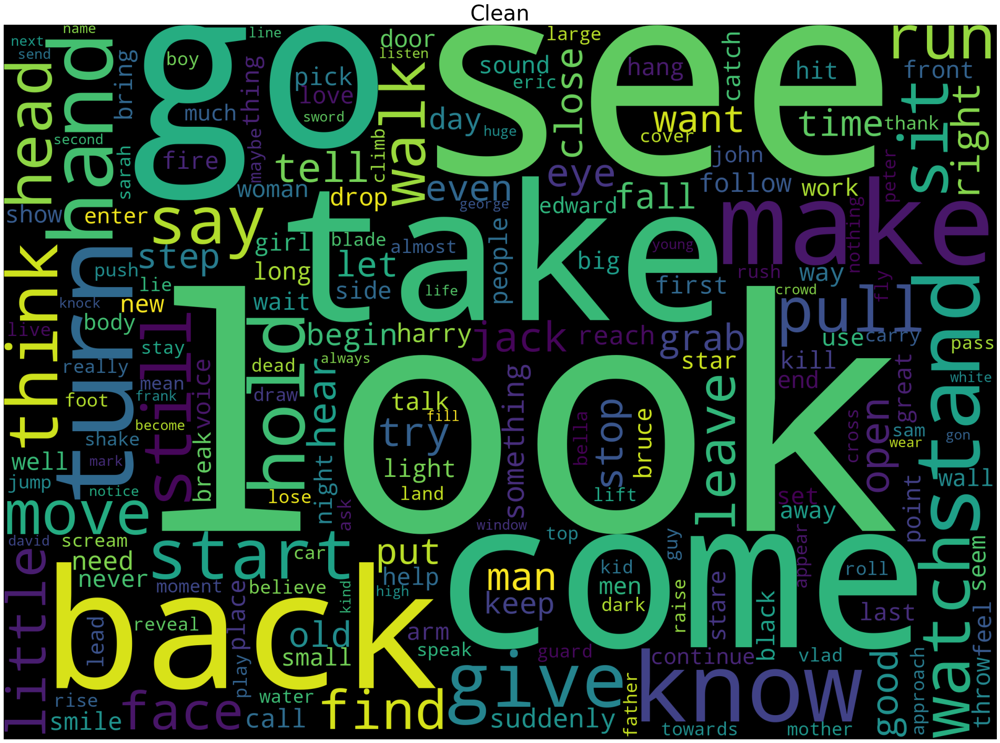

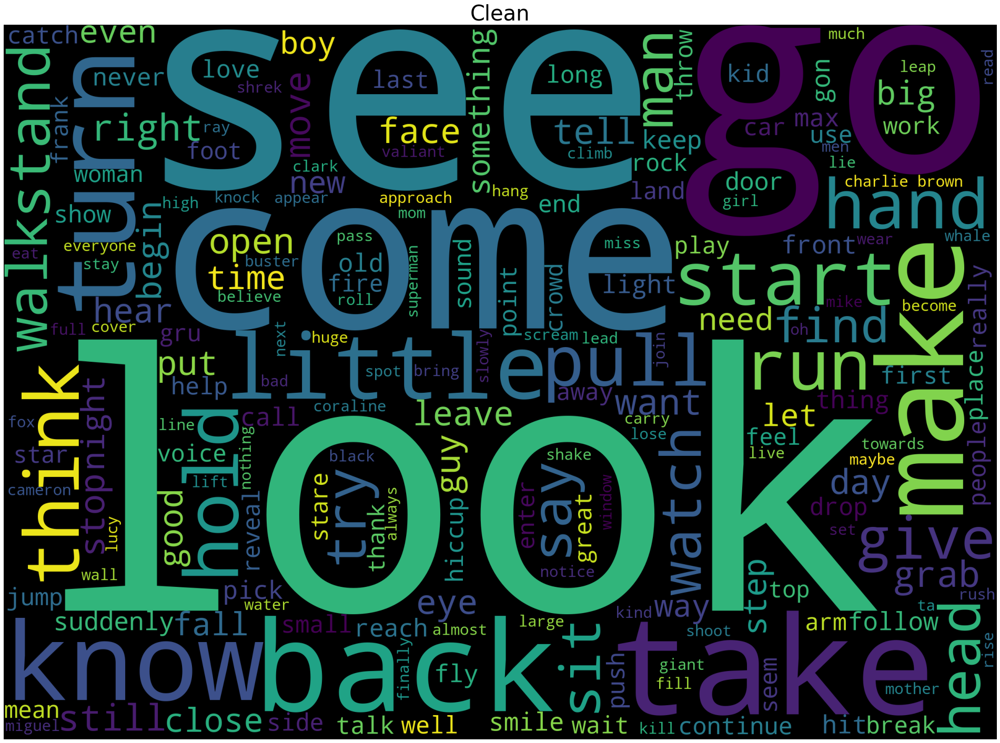

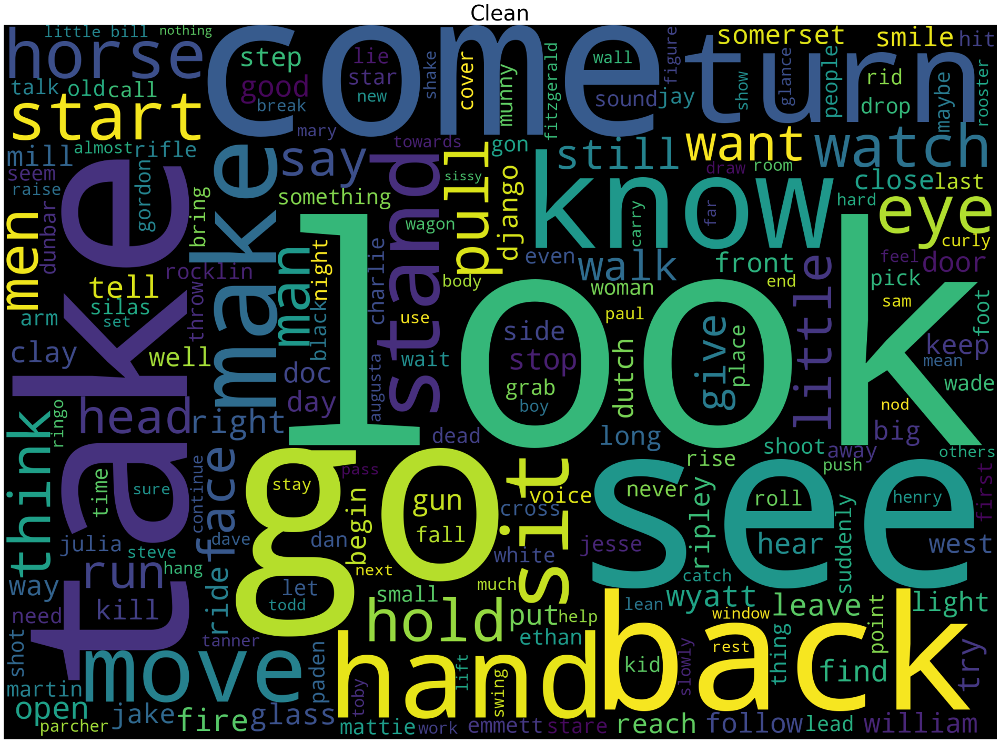

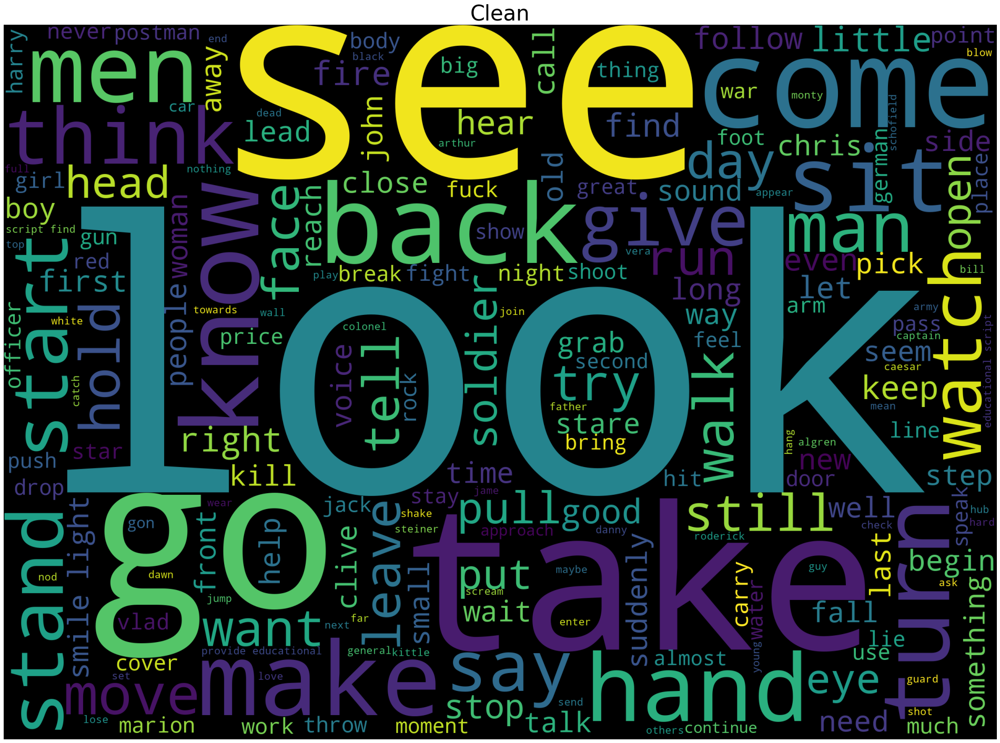

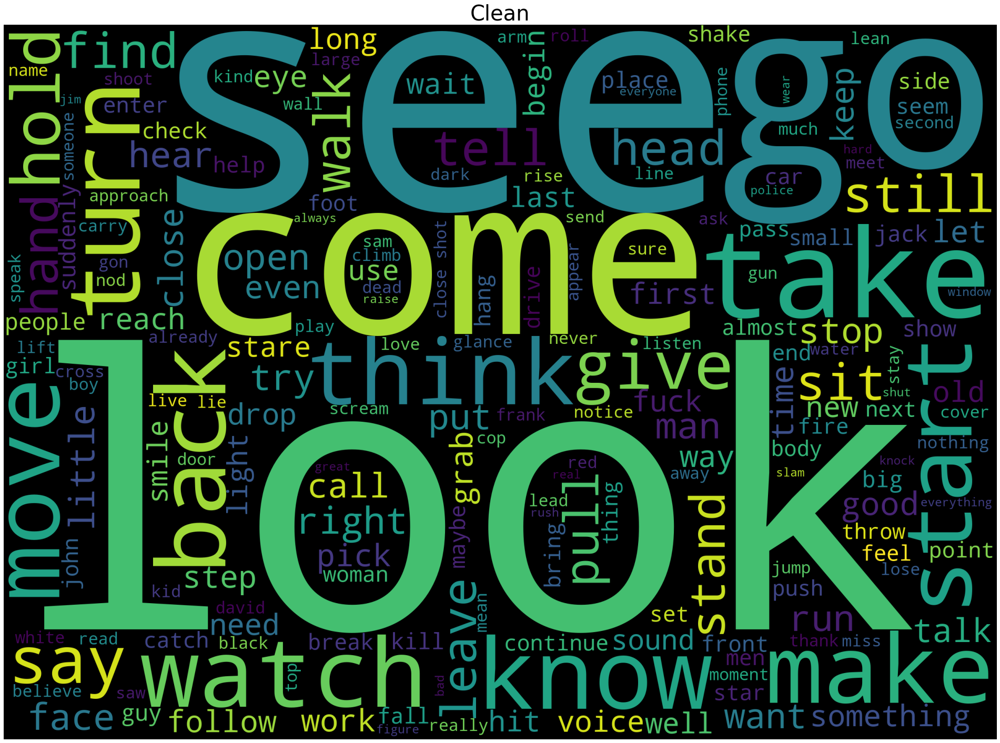

...

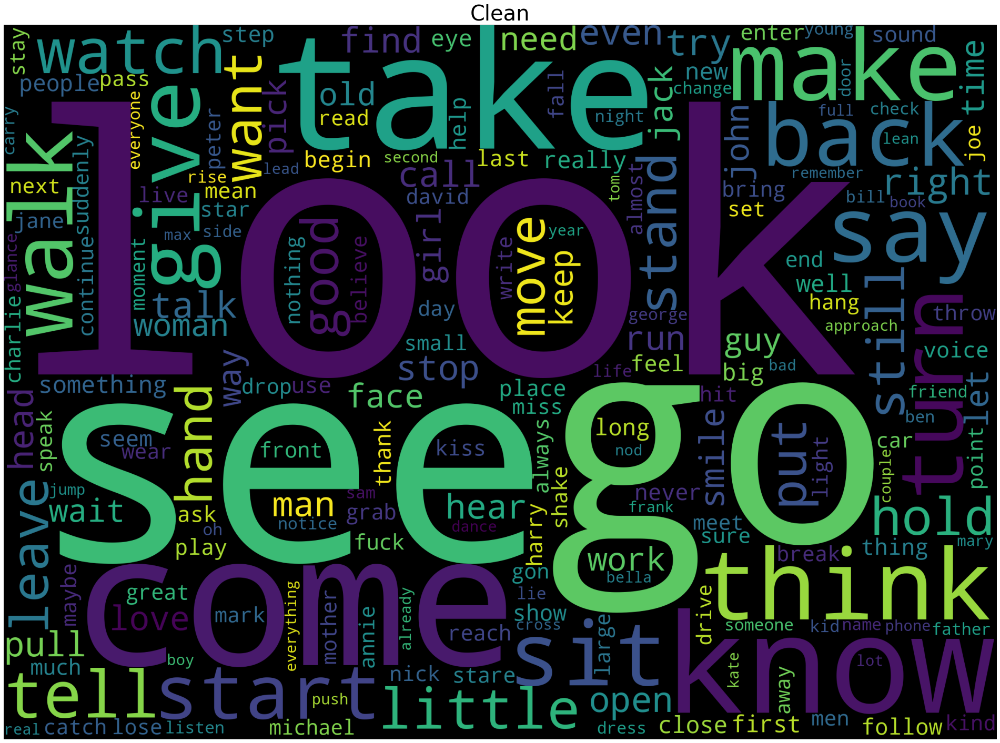

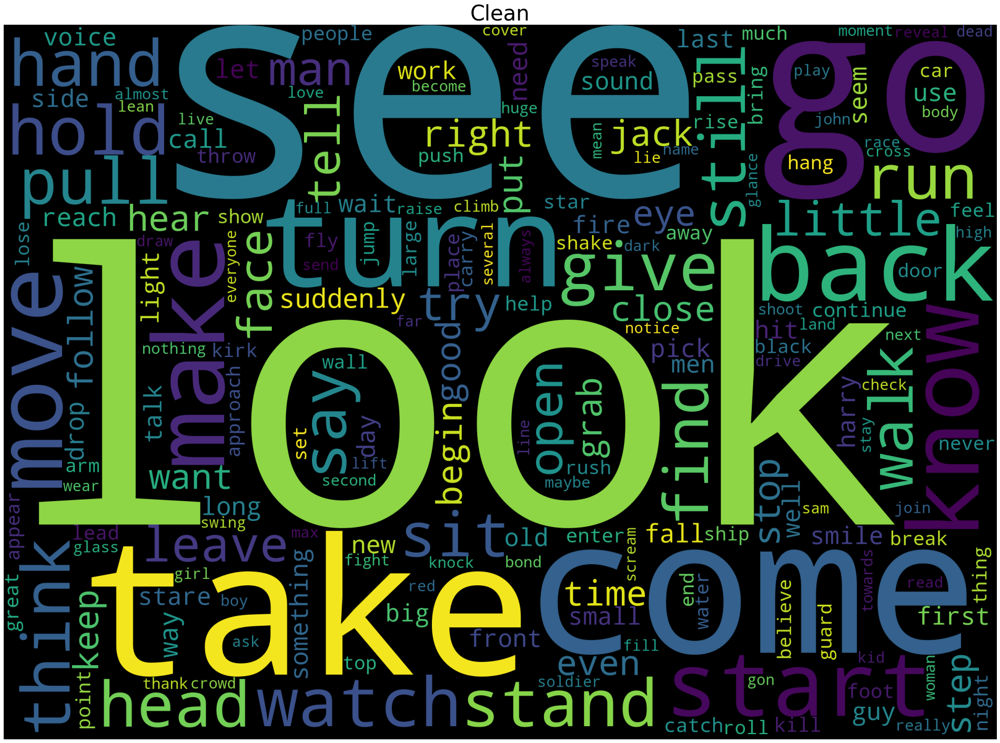

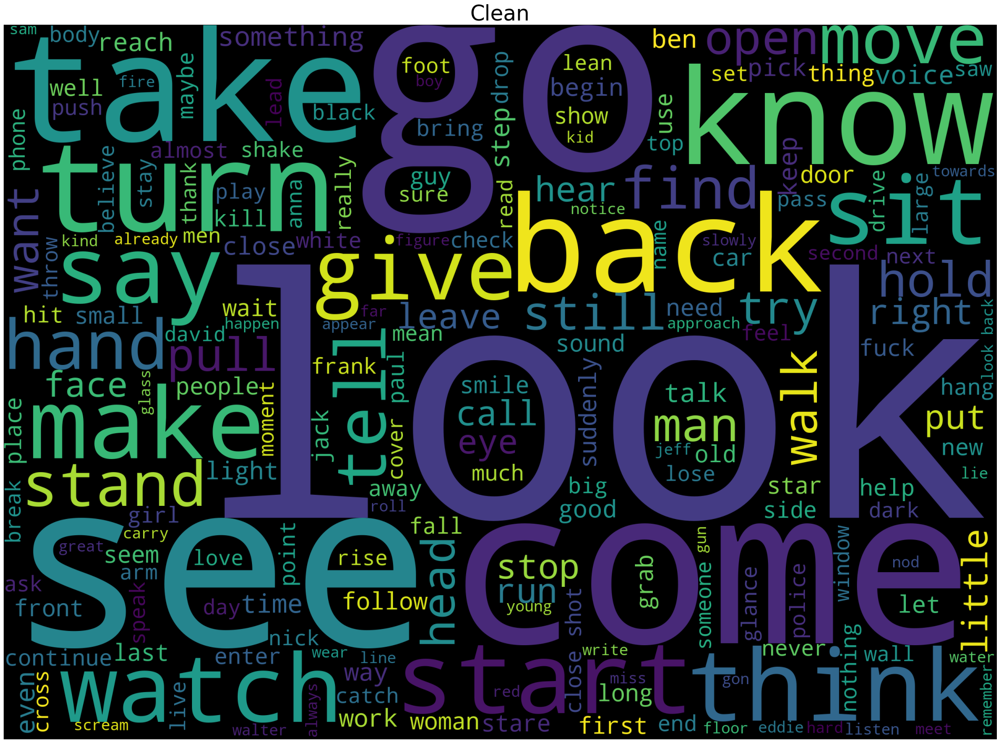

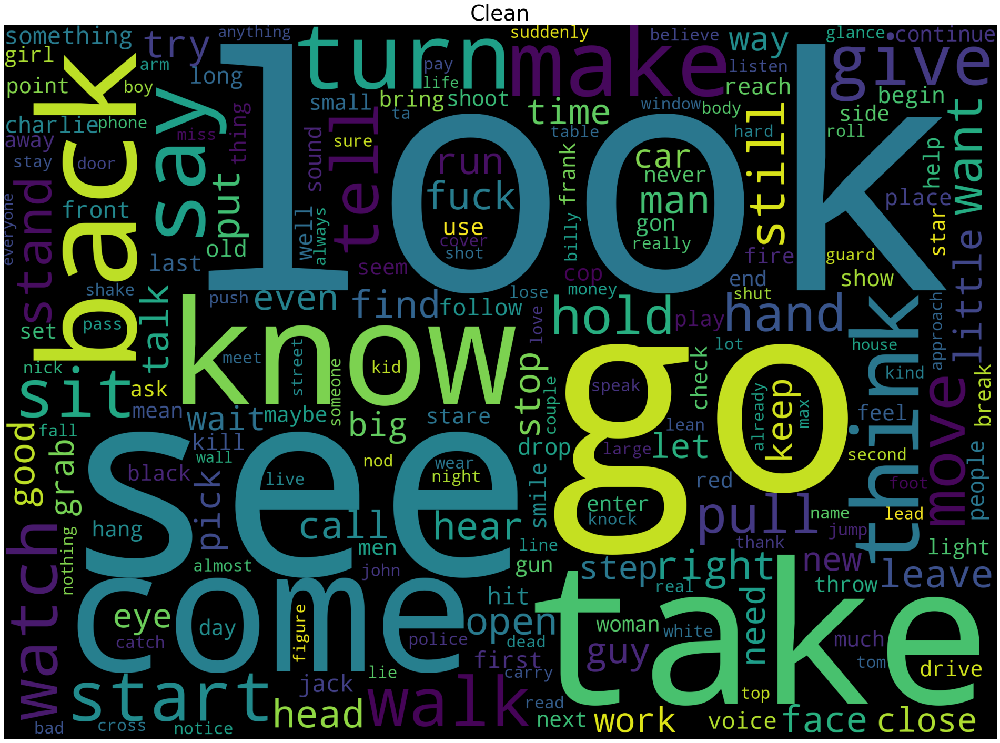

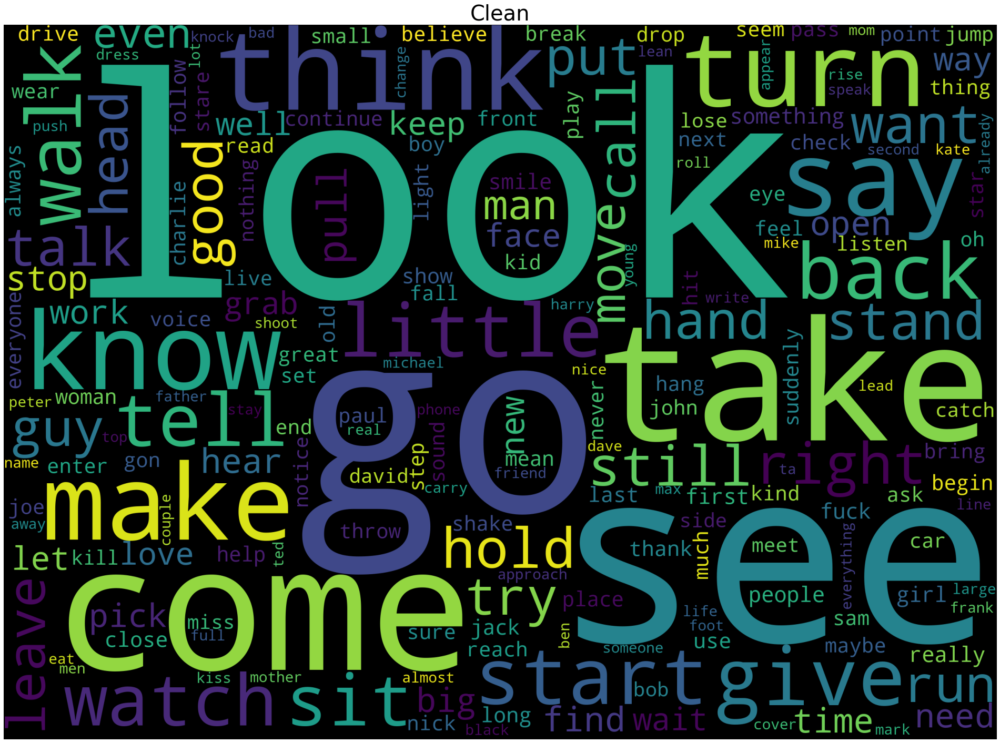

In [372]:
for i in dfs.keys():
    plt.figure(figsize=(40,25))
    # clean
    subset = dfs[i].lem
    cloud_toxic = WordCloud(
                            stopwords=STOPWORDS,
                            background_color='black',
                            collocations=True,
                            width=2500,
                            height=1800
                            ).generate(" ".join(subset))
    plt.axis('off')
    plt.title("Clean",fontsize=40)
    plt.imshow(cloud_toxic)
    

In [31]:
import collections

In [32]:
corpuses = {}

for i in dfs.keys():

    corpuses[i] =  " ".join(dfs[i].lem)



In [33]:
len(corpuses)

18

In [40]:
top_ten = {}

for i in corpuses.keys():

    oh_no = collections.Counter([x for x in corpuses[i].split()])
    
    words = []
    counts = []
    
    for word, count in oh_no.most_common(10):
        words.append(word)
        counts.append(count)

    top_ten['words {}'.format(i)] = words
    top_ten['counts {}'.format(i)] = counts

In [42]:
top_ten['words Music'], top_ten['counts Music']

(['get', 'look', 'go', 'see', 'come', 'back', 'take', 'know', 'day', 'want'],
 [6176, 5781, 4000, 3230, 2955, 2901, 2796, 2507, 2009, 1983])

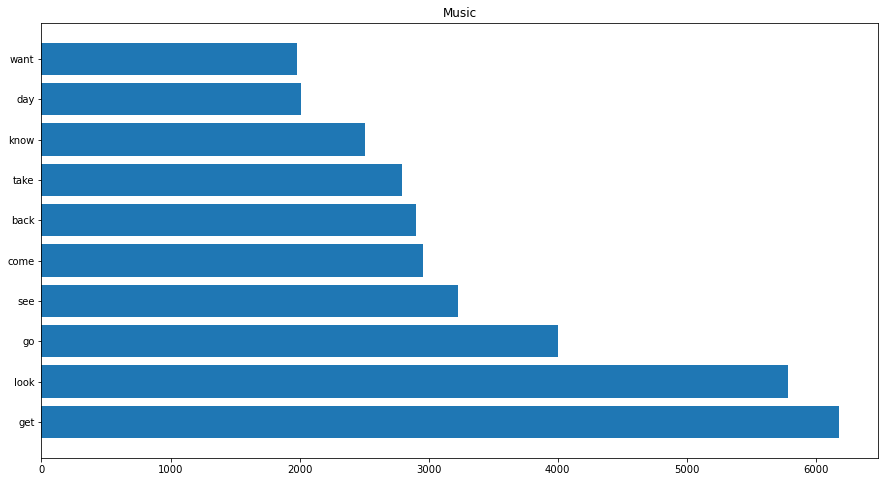

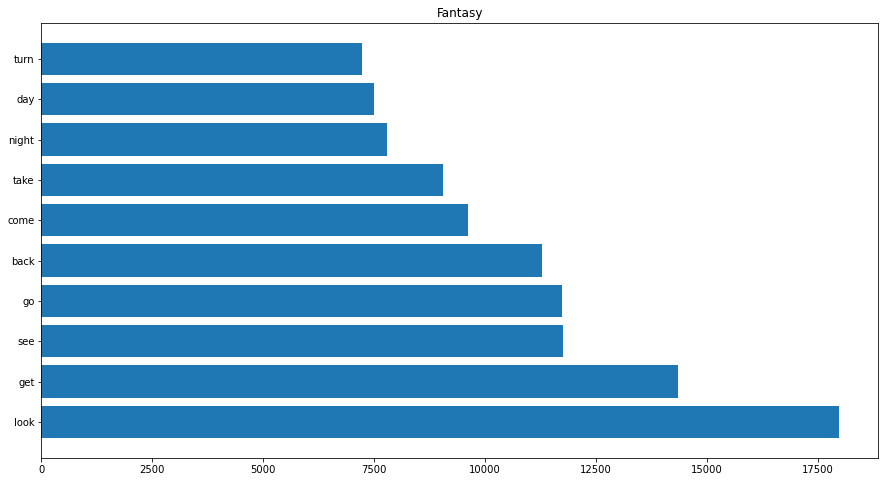

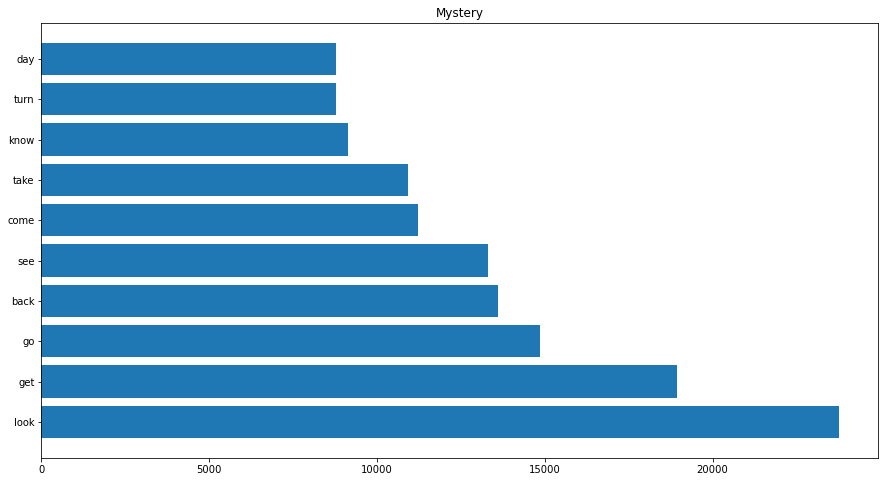

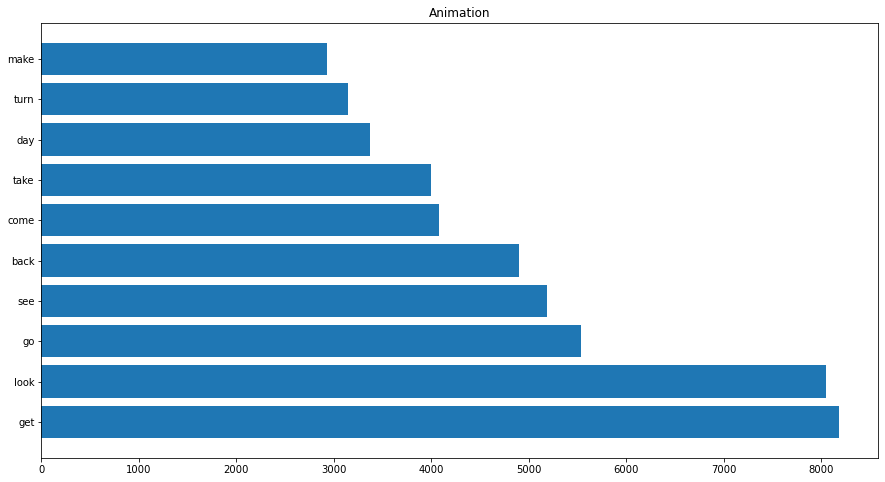

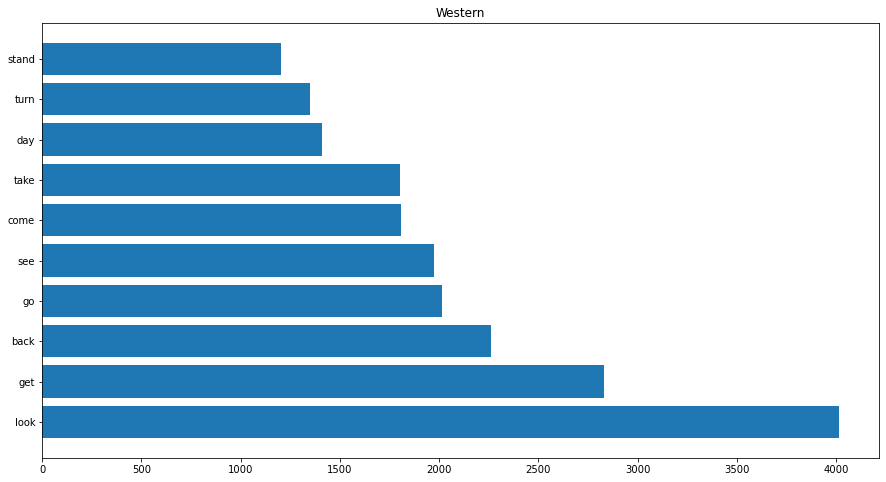

...

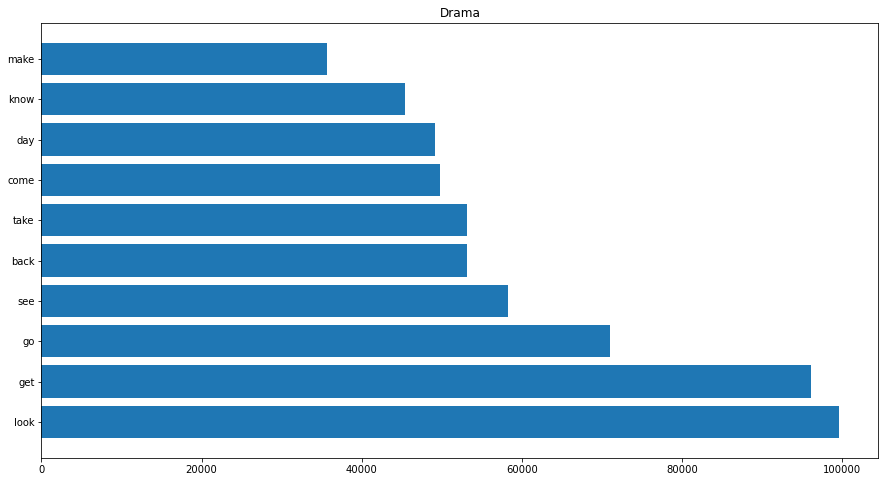

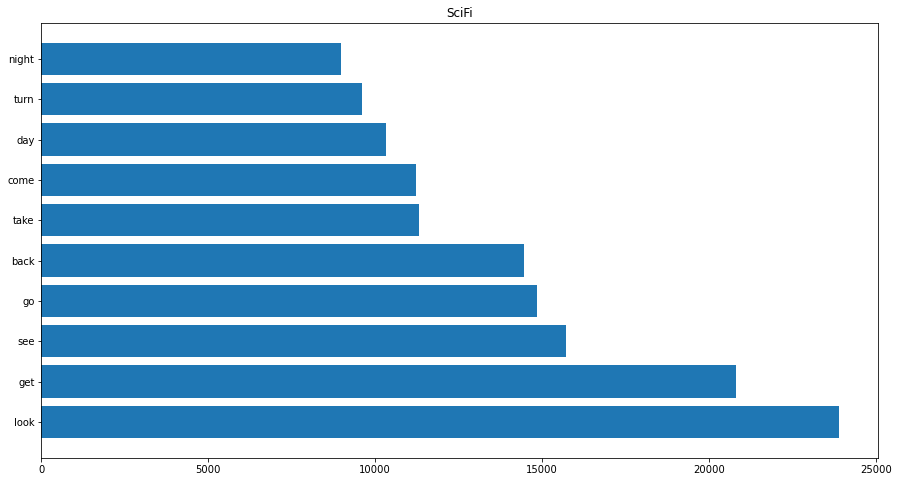

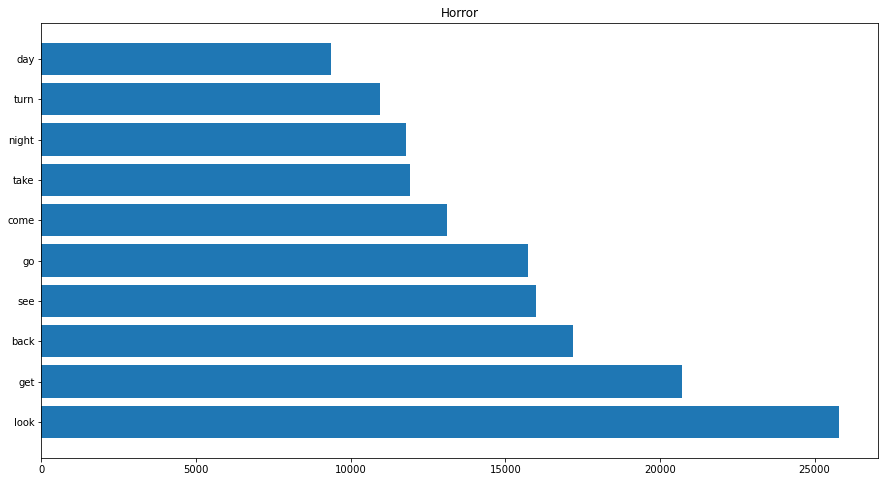

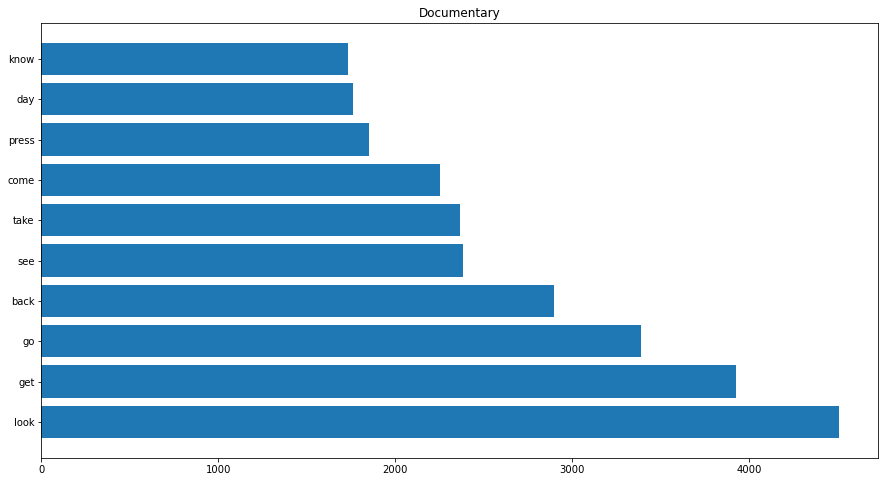

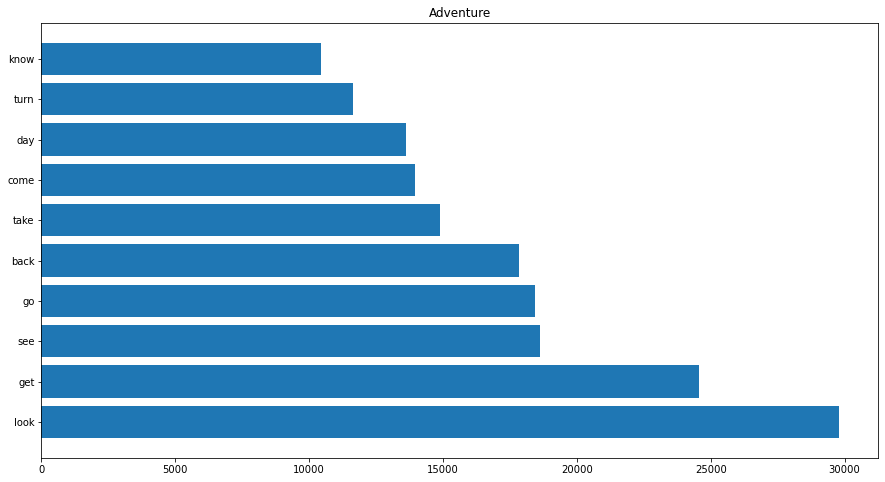

In [45]:
for i in corpuses.keys():

    fig, ax = plt.subplots(figsize=(15,8))

    ax.barh(list(range(len(top_ten['words {}'.format(i)]))), top_ten['counts {}'.format(i)])

    ax.set_yticks(list(range(len(top_ten['words {}'.format(i)]))))
    ax.set_yticklabels(top_ten['words {}'.format(i)])

    ax.set_title('{}'.format(i))

    plt.show()

In [56]:
top_ten = {}

for i in corpuses.keys():

    oh_no = collections.Counter([x for x in corpuses[i].split()])
    
    words = []
    counts = []
    
    for word, count in oh_no.most_common(100)[:70]:
        words.append(word)
        counts.append(count)

    top_ten['words {}'.format(i)] = words
    top_ten['counts {}'.format(i)] = counts

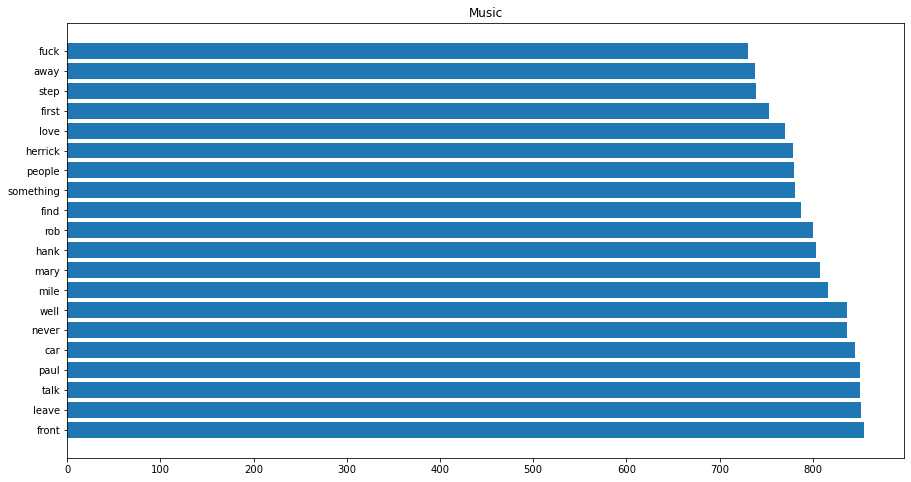

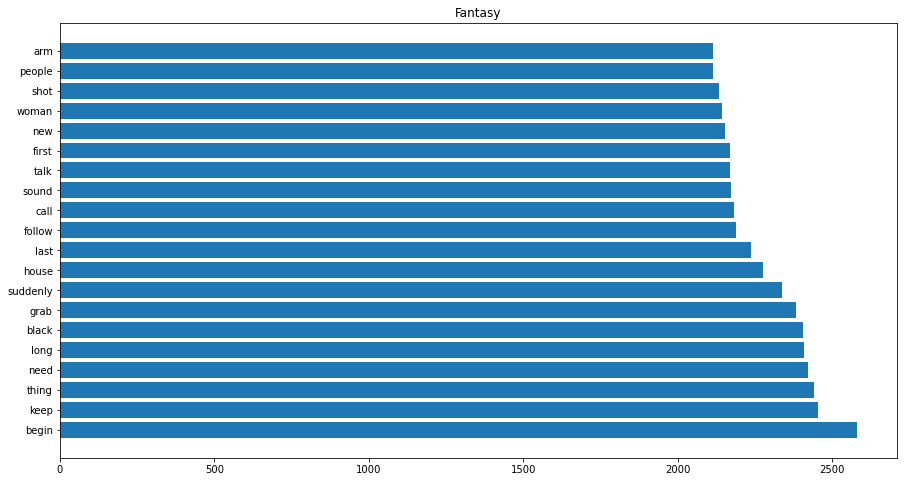

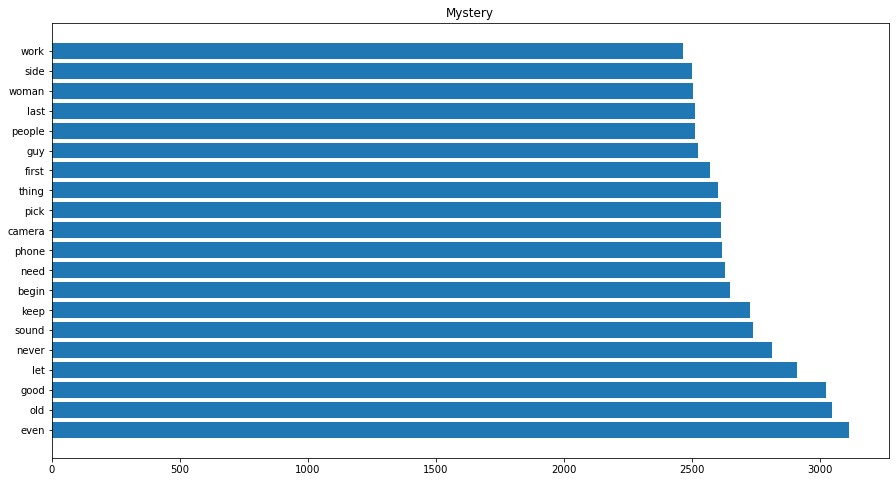

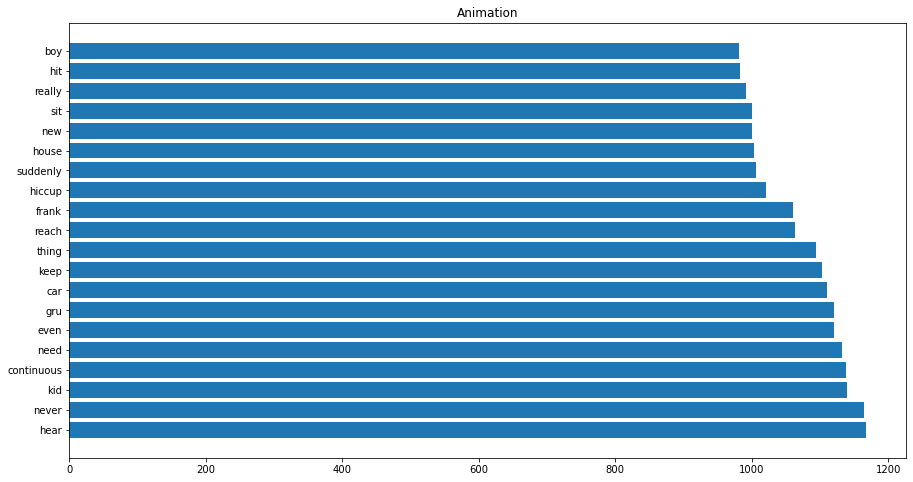

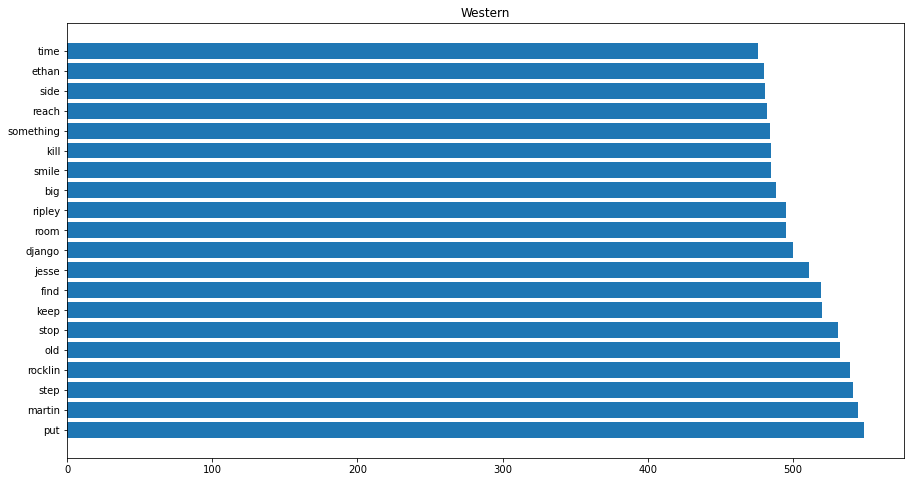

...

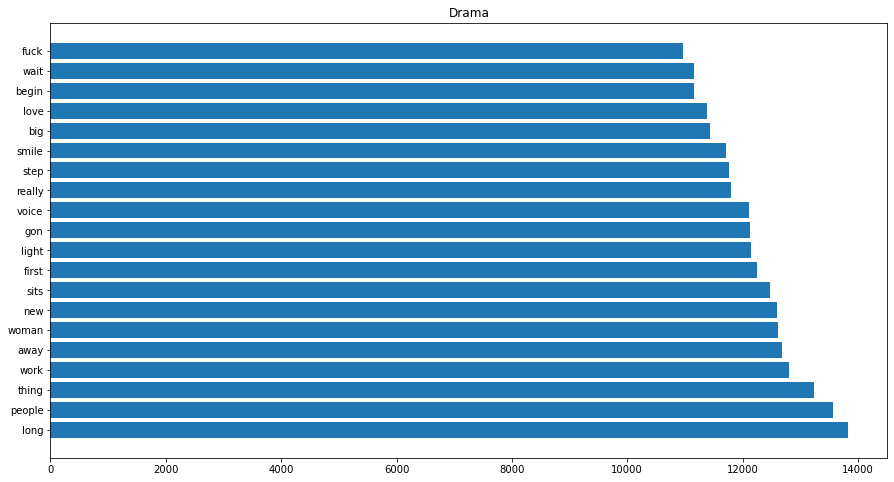

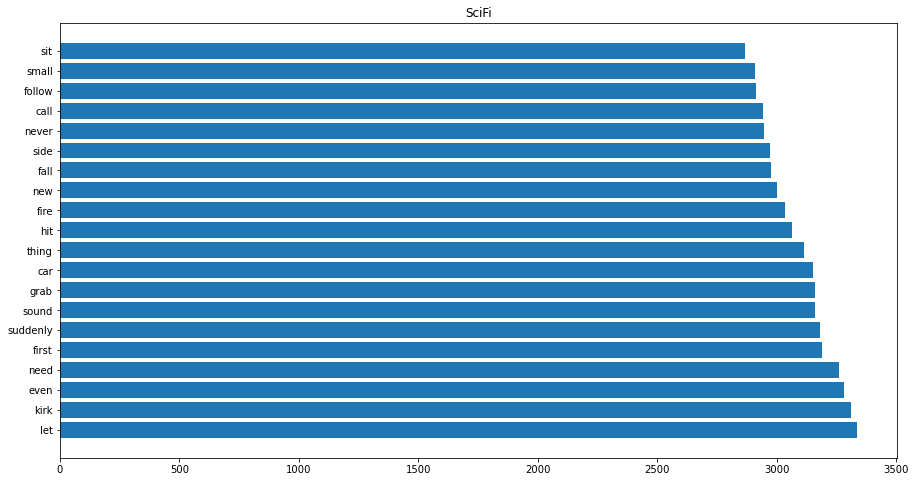

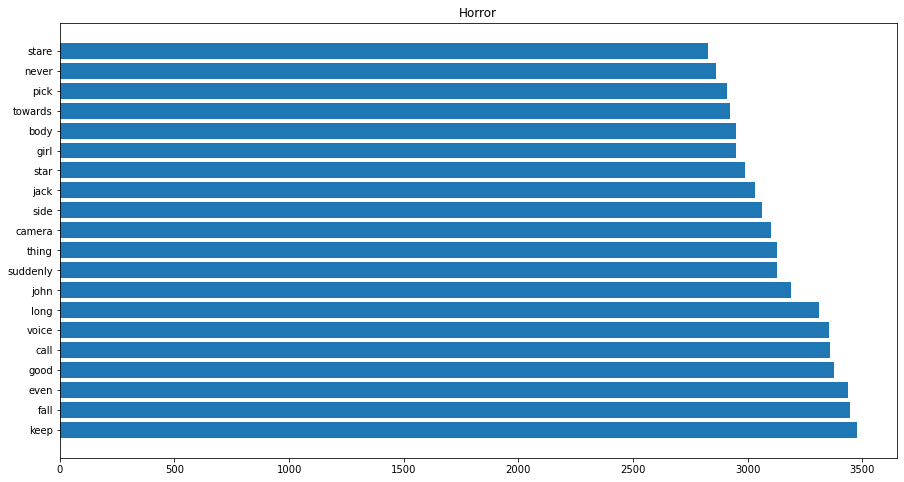

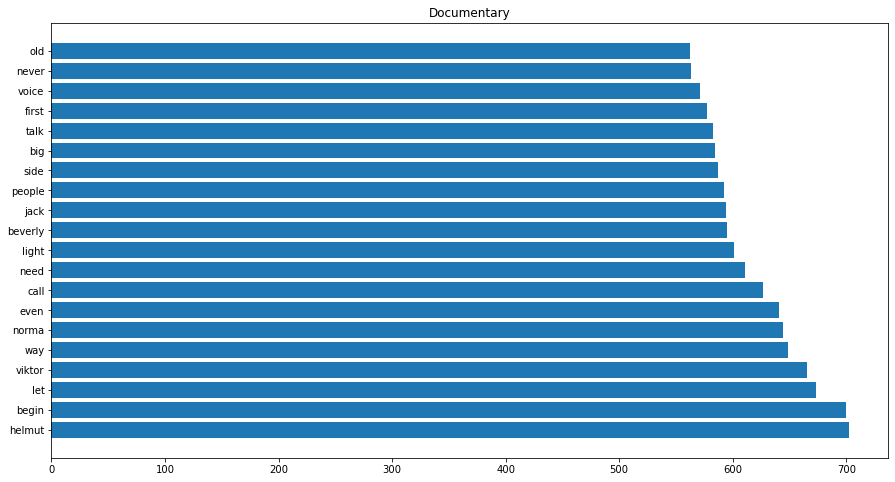

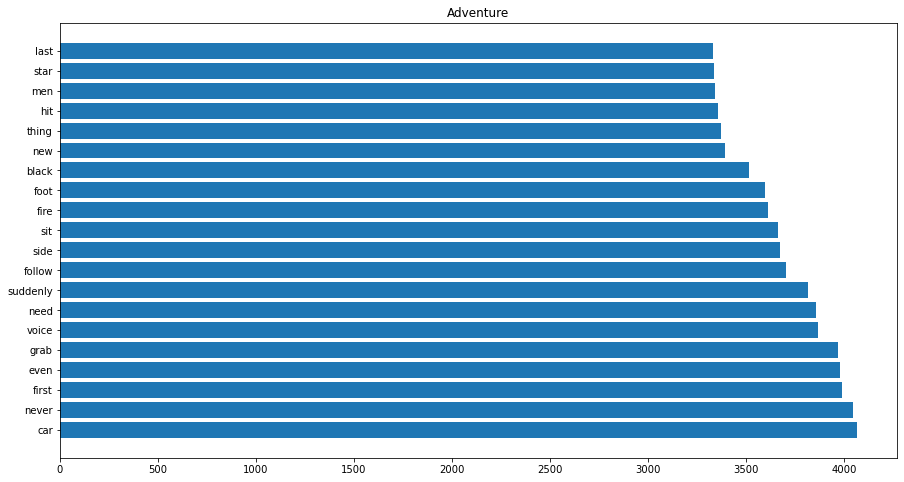

In [54]:
for i in corpuses.keys():
    
    fig, ax = plt.subplots(figsize=(15,8))

    ax.barh(list(range(len(top_ten['words {}'.format(i)]))), top_ten['counts {}'.format(i)])

    ax.set_yticks(list(range(len(top_ten['words {}'.format(i)]))))
    ax.set_yticklabels(top_ten['words {}'.format(i)])

    ax.set_title('{}'.format(i))

    plt.show()

In [57]:
import itertools

stops = []

for i in corpuses.keys():

    stops = itertools.chain(stops, top_ten['words {}'.format(i)])



stops = list(set(stops))
    


    

In [59]:
len(stops)

156

In [63]:
len(good_data.lem[0])

66448

In [71]:
len([x for x in good_data.lem[0].split() if x not in stops])

8308

In [66]:
def update_lem(row, stopping):
    
    new_row = [x for x in row.split() if x not in stopping]

    return " ".join(new_row)

In [72]:
len(update_lem(good_data.lem[0], stops).split())

8308

In [73]:
good_data['updates_lem'] = good_data.lem.apply(lambda x: update_lem(x, stops))

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


In [74]:
good_data.updates_lem

0       richard kelly september original text script n...
1       write judd apatow cute chunky jewish sort box ...
2       hate write karen mccullah lutz kirsten smith b...
3       roland emmerich harald kloser roland emmerich ...
4       write anthony cipriano neighborhood street mor...
                              ...                        
2120    jamie vanderbilt base book robert graysmith sh...
2121                                                     
2122    zoo keeper jay scherick ronn april baltimore z...
2123    original jar phil johnston story byron rich ja...
2124    dawn script appear year ago british colony nat...
Name: updates_lem, Length: 1968, dtype: object

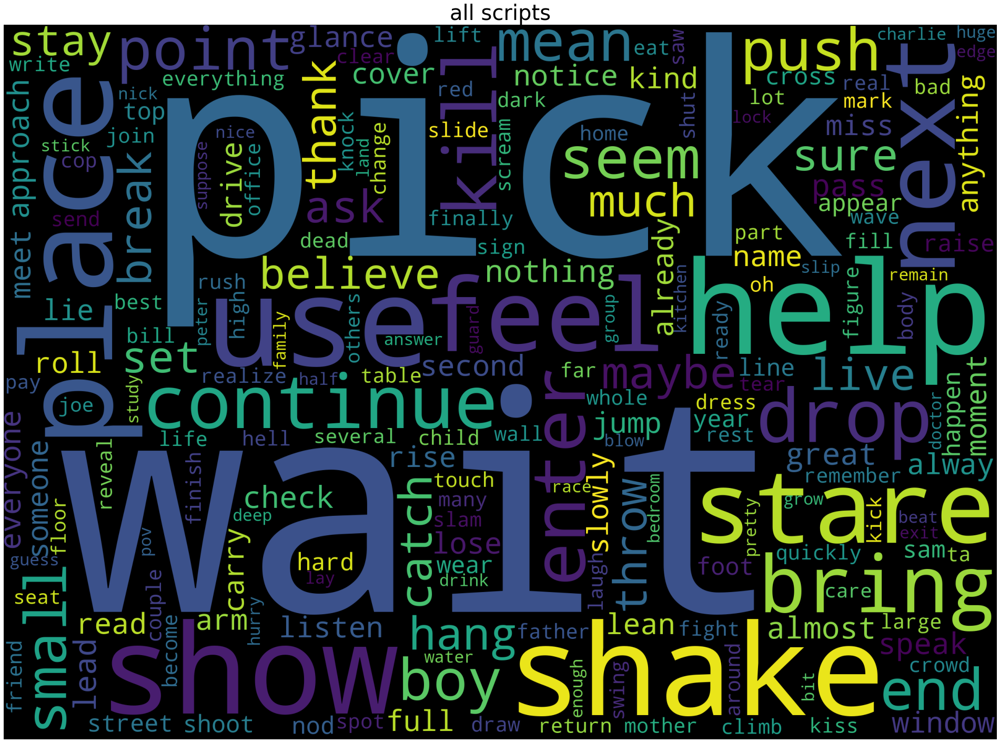

In [76]:
from wordcloud import WordCloud

plt.figure(figsize=(40,25))
# clean
subset = good_data.updates_lem
cloud_toxic = WordCloud(
                        background_color='black',
                        collocations=True,
                        width=2500,
                        height=1800
                        ).generate(" ".join(subset))
plt.axis('off')
plt.title("all scripts",fontsize=40)
plt.imshow(cloud_toxic)

In [78]:
for i in genre_lst:

    dfs[i]['update_lems'] = dfs[i].lem.apply(lambda x: update_lem(x, stops))

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


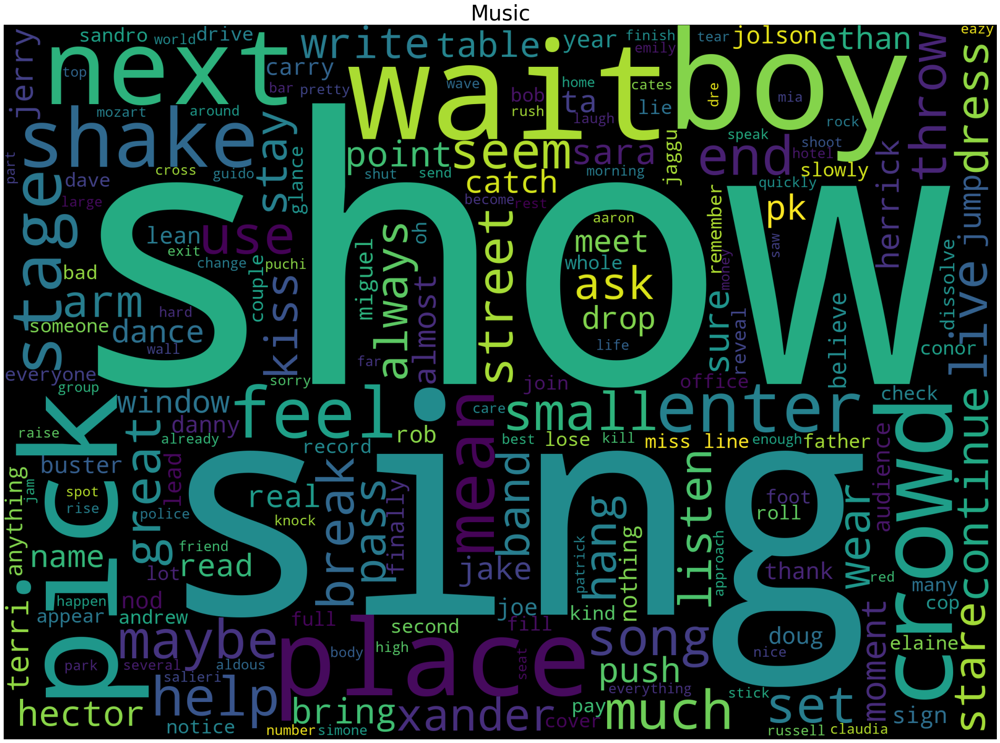

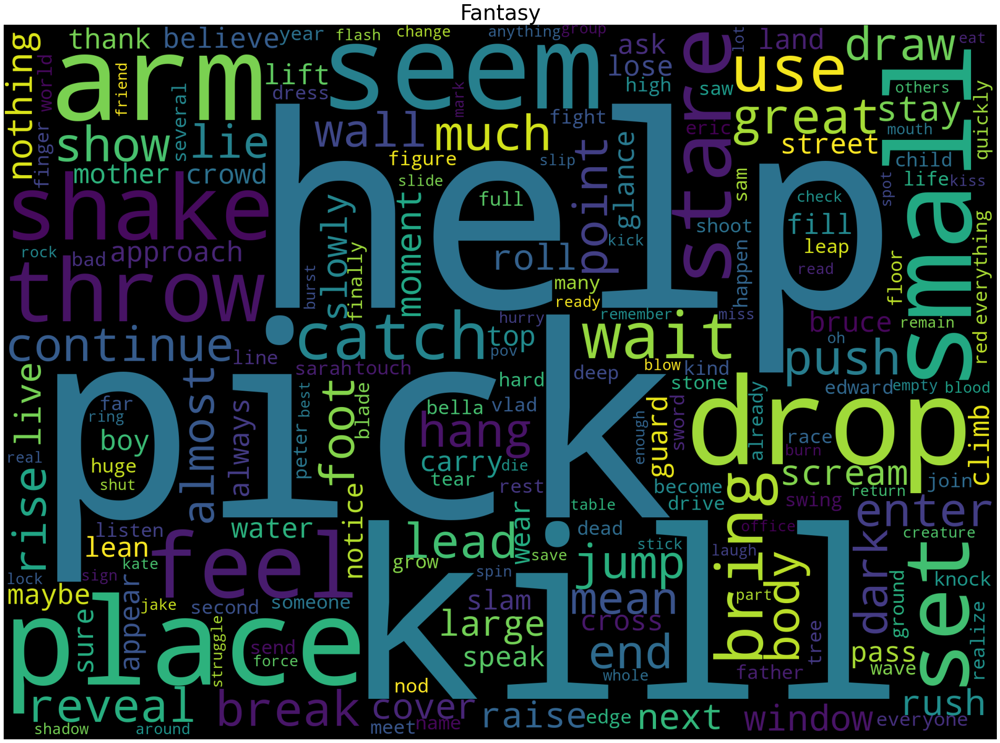

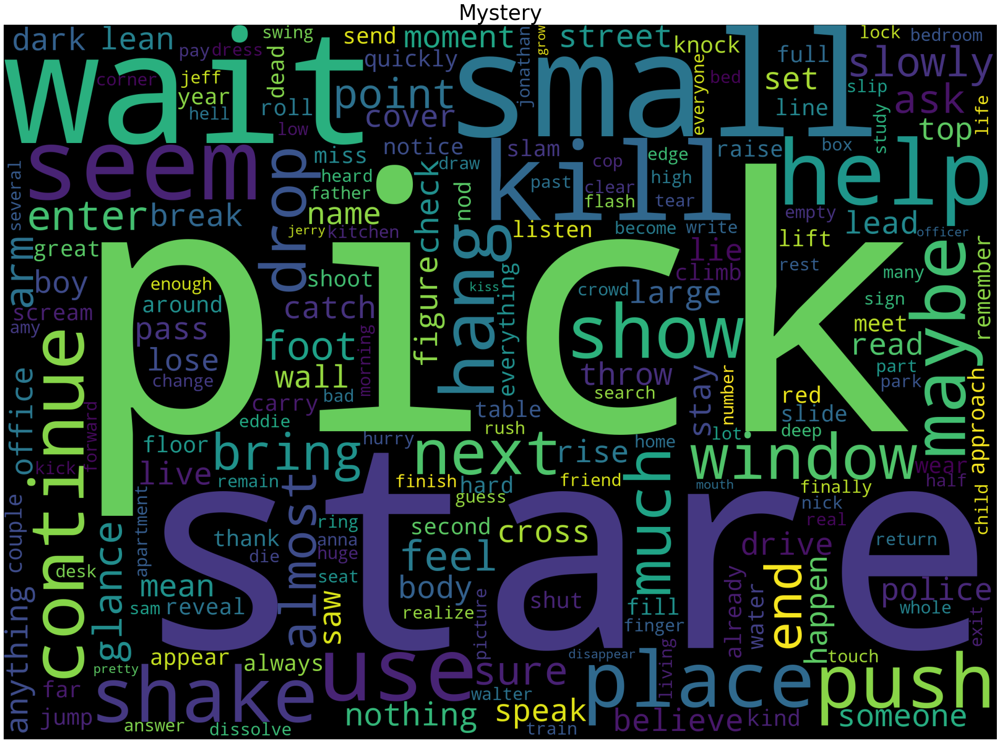

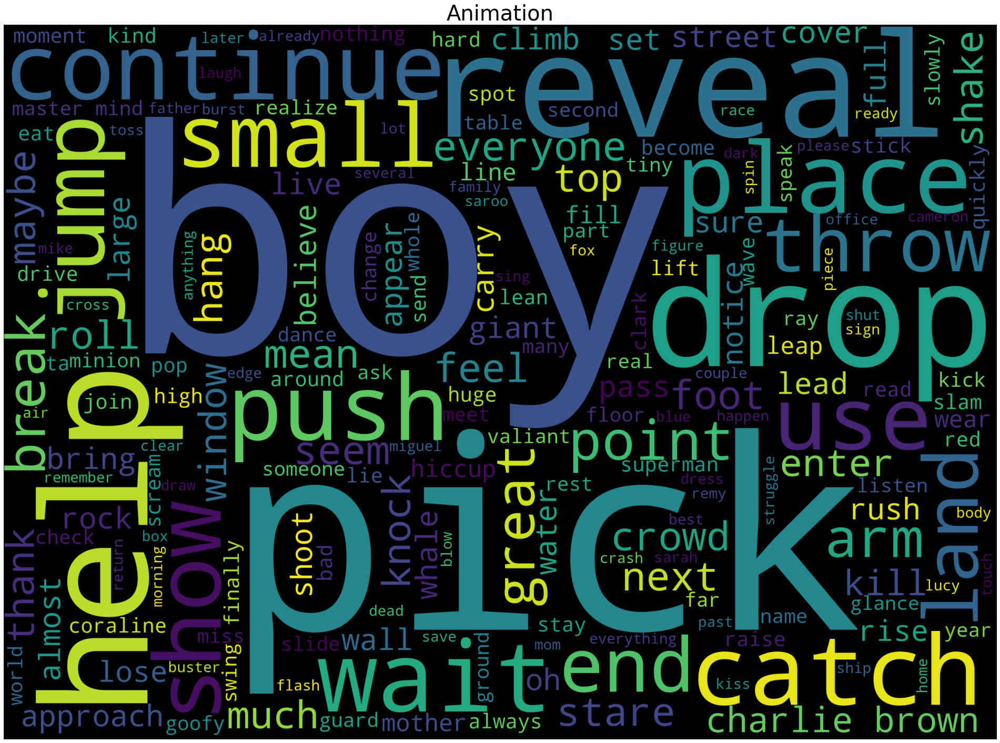

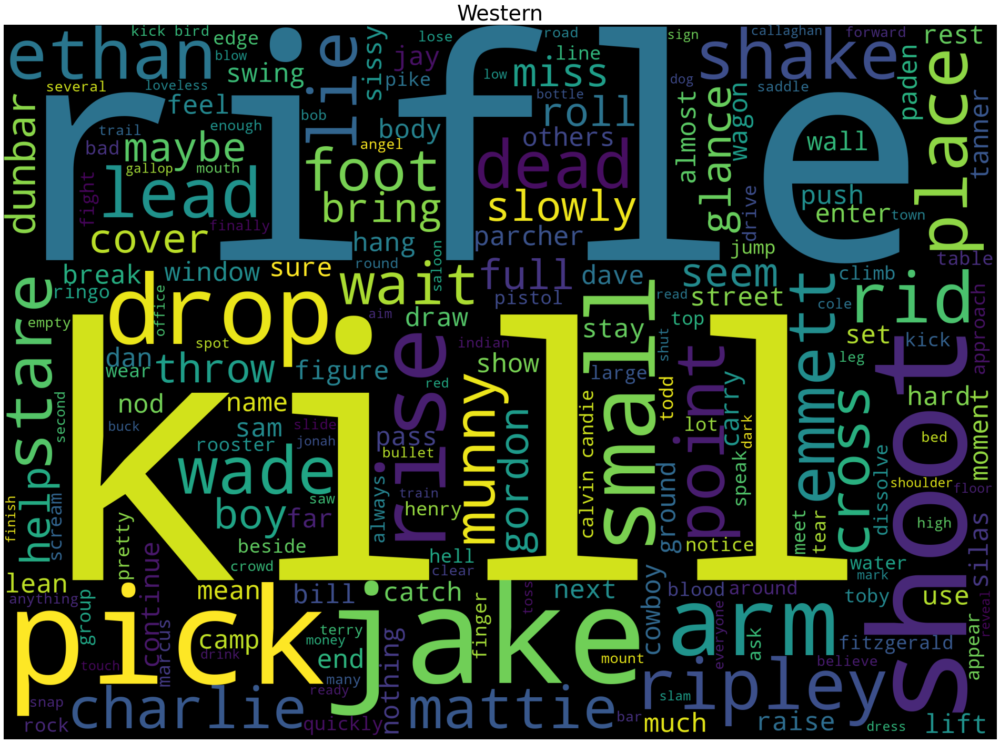

...

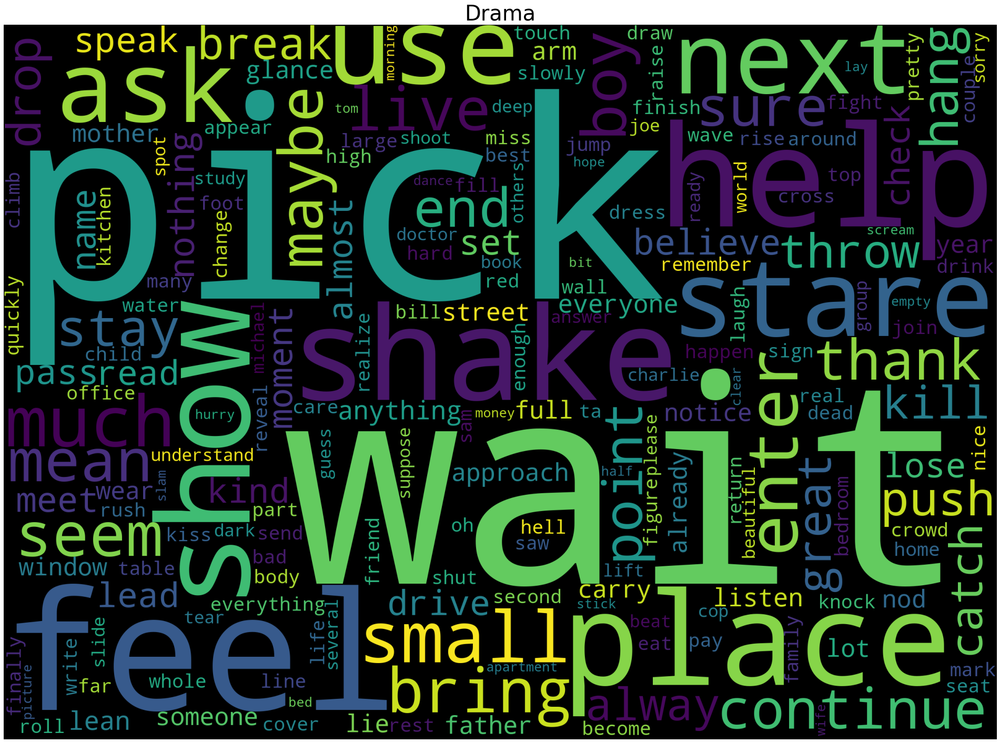

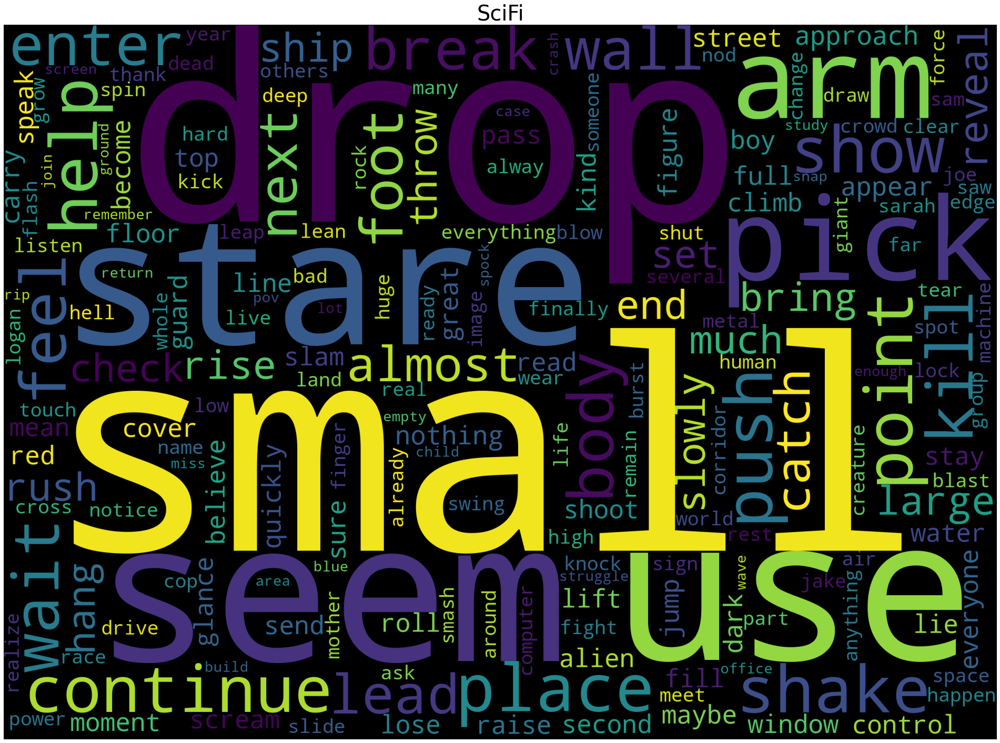

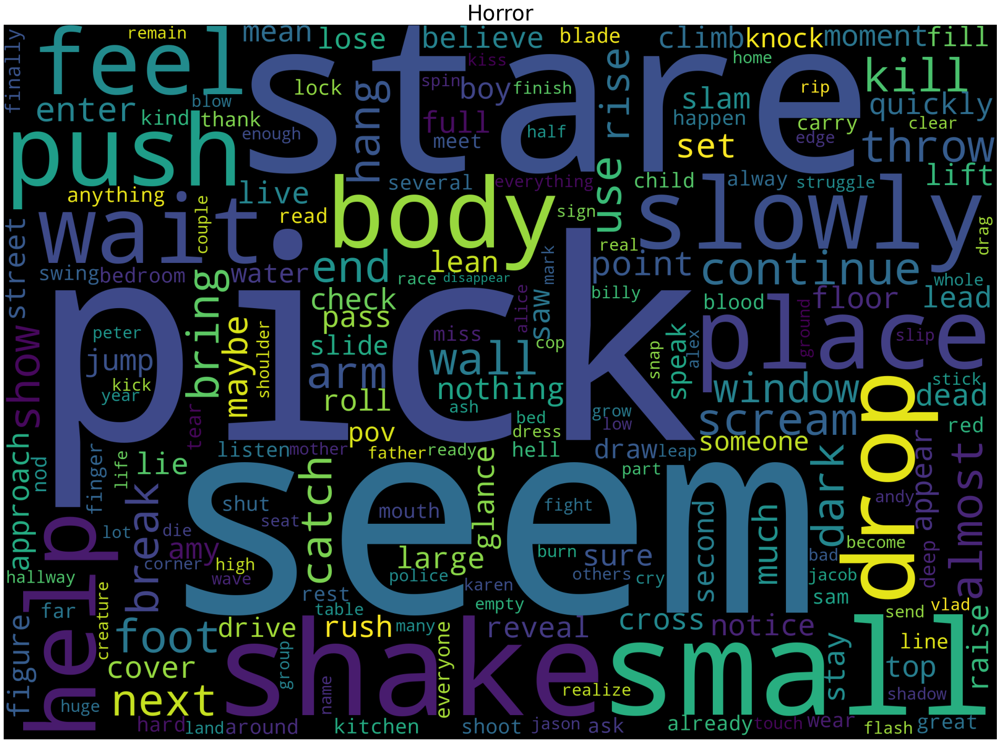

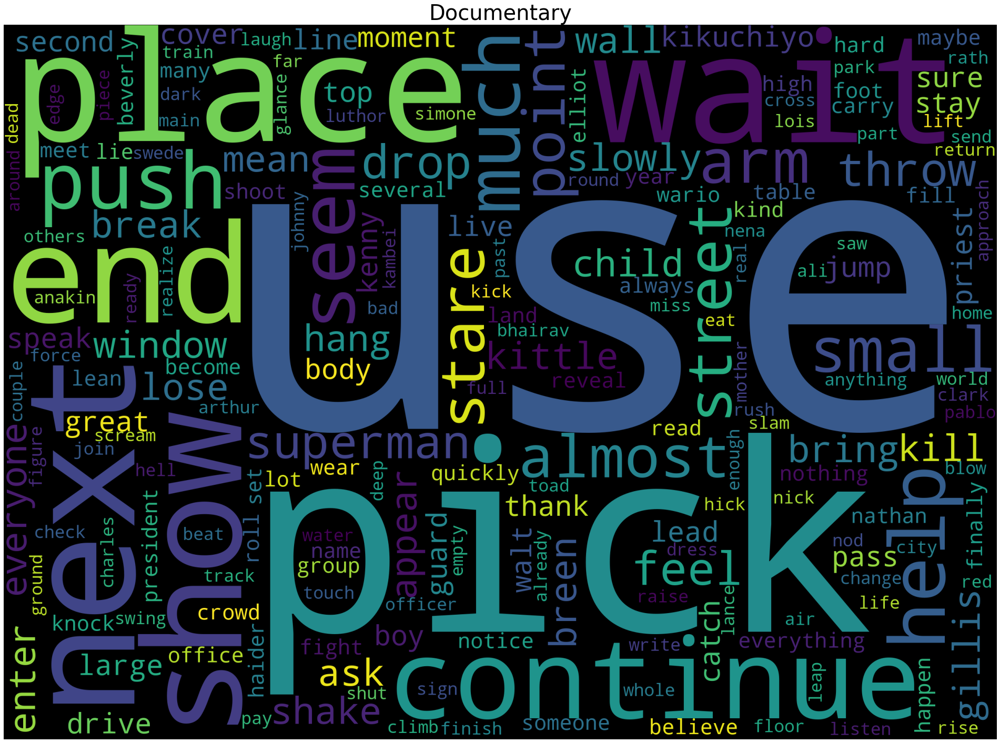

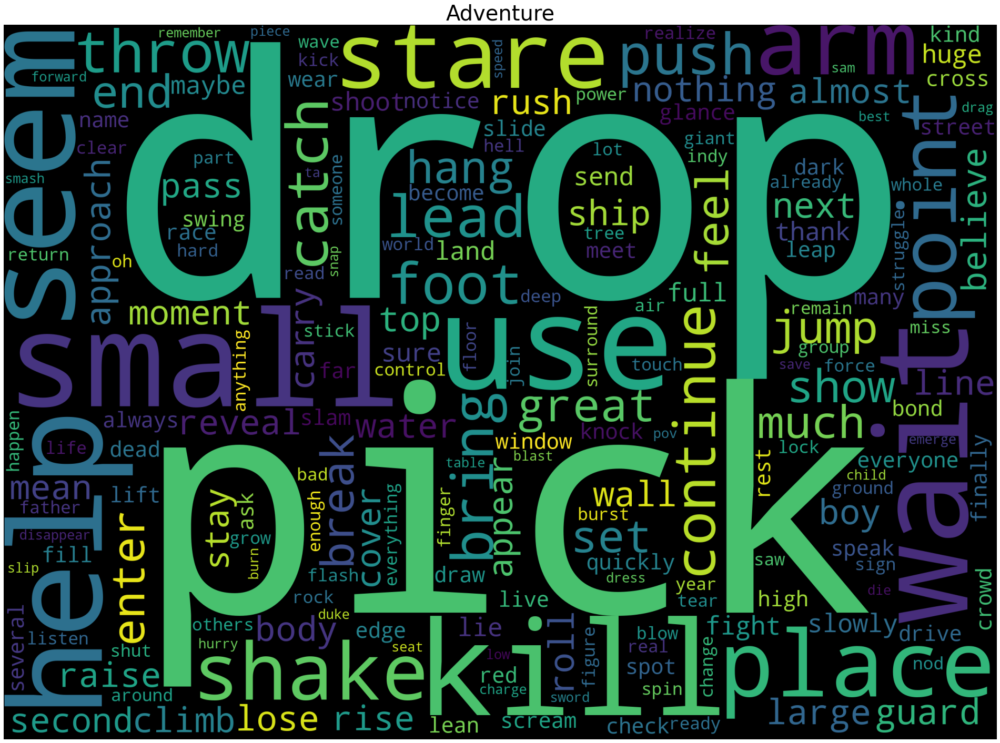

In [80]:
for i in dfs.keys():
    plt.figure(figsize=(40,25))
    # clean
    subset = dfs[i].update_lems
    cloud_toxic = WordCloud(
                            background_color='black',
                            collocations=True,
                            width=2500,
                            height=1800
                            ).generate(" ".join(subset))
    plt.axis('off')
    plt.title("{}".format(i), fontsize=40)
    plt.imshow(cloud_toxic)

In [81]:
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import plot_confusion_matrix
from sklearn.naive_bayes import MultinomialNB

In [85]:
from sklearn.model_selection import train_test_split

X = good_data.updates_lem
y = good_data.target
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.3, random_state = 42)


In [86]:
pipe = Pipeline([('cv', CountVectorizer()), ('mb', MultinomialNB(alpha=5))])

In [87]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('cv', CountVectorizer()), ('mb', MultinomialNB(alpha=5))])

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


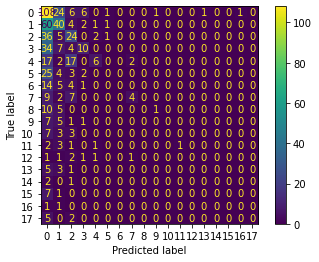

In [88]:
plot_confusion_matrix(pipe, X_test, y_test)

In [89]:
from sklearn.metrics import classification_report
print(classification_report(y_test, pipe.predict(X_test)))

              precision    recall  f1-score   support

           0       0.31      0.73      0.43       148
           1       0.36      0.37      0.37       108
           2       0.30      0.35      0.32        68
           3       0.43      0.18      0.26        55
           4       0.55      0.14      0.22        44
           5       0.00      0.00      0.00        34
           6       0.00      0.00      0.00        24
           7       0.57      0.18      0.28        22
           8       0.00      0.00      0.00        16
           9       0.00      0.00      0.00        14
          10       0.00      0.00      0.00        13
          11       1.00      0.12      0.22         8
          12       0.00      0.00      0.00         7
          13       0.00      0.00      0.00         9
          14       0.00      0.00      0.00         3
          15       0.00      0.00      0.00         8
          16       0.00      0.00      0.00         2
          17       0.00    

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [90]:
good_data

,title,text,genre,genre_amount,Music,Fantasy,Mystery,Animation,Western,History,...,War,Drama,SciFi,Horror,Documentary,Adventure,clean,lem,updates_lem,target
0,Domino,b'D O M I N O\r\n...,"[Thriller, Action, Crime]",3,0,0,0,0,0,0,...,0,0,0,0,0,0,By Richard Kelly September THE ORIGINAL TEXT O...,richard kelly september original text script n...,richard kelly september original text script n...,6
1,Knocked Up,b'KNOCKED UP\r\n\r\nWritten by\r\n\r\nJudd Apa...,"[Comedy, Romance, Drama]",3,0,0,0,0,0,0,...,0,1,0,0,0,0,UP Written by Judd Apatow HOUSE DAY BEN cute i...,write judd apatow house day cute chunky jewish...,write judd apatow cute chunky jewish sort box ...,1
2,10 Things I Hate About You,b'TEN THINGS I HATE ABOUT YOU\r\n\r\nwritten b...,"[Comedy, Romance, Drama]",3,0,0,0,0,0,0,...,0,1,0,0,0,0,THINGS HATE ABOUT YOU written by Karen McCulla...,thing hate write karen mccullah lutz kirsten s...,hate write karen mccullah lutz kirsten smith b...,1
3,10000 B C,"b""10,000 B.C.\r\nby\r\nRoland Emmerich & Haral...","[Adventure, Action, Drama, Fantasy]",4,0,1,0,0,0,0,...,0,1,0,0,0,1,by Roland Emmerich Harald Kloser Roland Emmeri...,roland emmerich harald kloser roland emmerich ...,roland emmerich harald kloser roland emmerich ...,4
4,12 And Holding,b'12 AND HOLDING\r\n\r\nWritten by\r\n\r\nAnth...,[Drama],1,0,0,0,0,0,0,...,0,1,0,0,0,0,AND HOLDING Written by Anthony Cipriano FADE N...,hold write anthony cipriano neighborhood stree...,write anthony cipriano neighborhood street mor...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2120,Zodiac,b'CHRONICLES\r\nby\r\nJamie Vanderbilt\r\n\r\n...,"[Crime, Drama, Mystery, Thriller]",4,0,0,1,0,0,0,...,0,1,0,0,0,0,by Jamie Vanderbilt Based on the books and by ...,jamie vanderbilt base book robert graysmith wh...,jamie vanderbilt base book robert graysmith sh...,5
2121,Zombieland,b'\xef\x81\x9a\xef\x81\x8f\xef\x81\x8d\xef\x81...,"[Comedy, Horror]",2,0,0,0,0,0,0,...,0,0,0,1,0,0,,,,1
2122,Zookeeper,"b""The Zoo Keeper\r\nby\r\nJay Scherick & David...","[Comedy, Romance, Family]",3,0,0,0,0,0,0,...,0,0,0,0,0,0,Zoo Keeper by Jay Scherick David Ronn April BA...,zoo keeper jay scherick david ronn april balti...,zoo keeper jay scherick ronn april baltimore z...,1
2123,Zootopia,"b""ZOOTOPIA\r\n\r\nOriginal Screenplay by\r\nJa...","[Animation, Adventure, Family, Comedy]",4,0,0,0,1,0,0,...,0,0,0,0,0,1,Original Screenplay by Jared Phil Johnston Sto...,original jar phil johnston story byron rich ja...,original jar phil johnston story byron rich ja...,9


In [92]:
cols = genre_lst
cols.append('updates_lem')


In [108]:
model_data = good_data.loc[:, cols]

In [109]:
model_data

,Music,Fantasy,Mystery,Animation,Western,History,Family,Crime,Romance,Thriller,Comedy,Action,War,Drama,SciFi,Horror,Documentary,Adventure,updates_lem
0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0,richard kelly september original text script n...
1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,write judd apatow cute chunky jewish sort box ...
2,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,hate write karen mccullah lutz kirsten smith b...
3,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,roland emmerich harald kloser roland emmerich ...
4,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,write anthony cipriano neighborhood street mor...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2120,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,jamie vanderbilt base book robert graysmith sh...
2121,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,
2122,0,0,0,0,0,0,1,0,1,0,1,0,0,0,0,0,0,0,zoo keeper jay scherick ronn april baltimore z...
2123,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,1,original jar phil johnston story byron rich ja...


In [114]:
X = model_data.updates_lem.copy()
y = model_data.drop(columns=['updates_lem'], axis=1)

In [115]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [116]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.multiclass import OneVsRestClassifier

In [118]:
lgr_pipe = Pipeline([('cv', CountVectorizer(ngram_range=(1,3))),('clf', OneVsRestClassifier(LogisticRegression(solver='sag')))])

for g in genre_lst:
    print(g)

    lgr_pipe.fit(X_train, y_train[g])

    pred = lgr_pipe.predict(X_test)

    print('Accuracy = {}'.format(accuracy_score(y_test[g], pred)))

Music


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.9694915254237289
Fantasy


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.9067796610169492
Mystery


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.8627118644067797
Animation


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.9491525423728814
Western


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.9813559322033898
History


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.9559322033898305
Family


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.940677966101695
Crime


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.8152542372881356
Romance


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.8084745762711865
Thriller


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.7559322033898305
Comedy


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.7152542372881356
Action


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.8372881355932204
War


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.976271186440678
Drama


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.6474576271186441
SciFi


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.9050847457627119
Horror


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.8593220338983051
Documentary


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.9745762711864406
Adventure


C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Accuracy = 0.8694915254237288
updates_lem


KeyError: 'updates_lem'

In [121]:
genre_lst.remove('updates_lem')

In [123]:
cols = genre_lst.copy()

In [124]:
cols.append('updates_lem')

In [128]:
pip install scikit-multilearn

     ---------------------------------------- 89.4/89.4 KB 4.9 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'C:\Users\mikey\anaconda3\envs\contest_env\python.exe -m pip install --upgrade pip' command.


In [136]:
from skmultilearn.problem_transform import BinaryRelevance, ClassifierChain
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import hamming_loss

In [135]:

pipe_two = Pipeline([('cv', CountVectorizer()), ('model', ClassifierChain(LogisticRegression()))])

pipe_two.fit(X_train, y_train)

y_pred = pipe_two.predict(X_test)

print(accuracy_score(y_test, y_pred))

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.

0.08644067796610169


In [137]:
hamming_loss(y_test, y_pred)

0.13681732580037664

In [139]:
from skmultilearn.problem_transform import LabelPowerset

pipe_three = Pipeline([('cv', CountVectorizer()), ('model', LabelPowerset(LogisticRegression()))])

pipe_three.fit(X_train, y_train)

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Pipeline(steps=[('cv', CountVectorizer()),
                ('model',
                 LabelPowerset(classifier=LogisticRegression(),
                               require_dense=[True, True]))])

In [140]:
pred_2 = pipe_three.predict(X_test)

print(hamming_loss(y_test, pred_2))

0.17570621468926553


In [153]:
from skmultilearn.adapt import MLkNN
from scipy.sparse import csr_matrix, lil_matrix

In [154]:
model_cl = MLkNN(k=10)

cv = CountVectorizer()
X_train_cv = lil_matrix(cv.fit_transform(X_train)).toarray()
X_test_cv = lil_matrix(cv.transform(X_test)).toarray()
y_train_mat = lil_matrix(y_train).toarray()



In [155]:
model_cl.fit(X_train_cv, y_train_mat)

TypeError: __init__() takes 1 positional argument but 2 were given

In [157]:
from sklearn.tree import DecisionTreeClassifier

pipe_nine = Pipeline([('cv', CountVectorizer()), ('model', ClassifierChain(DecisionTreeClassifier()))])

pipe_nine.fit(X_train, y_train)

y_pred = pipe_nine.predict(X_test)

print(hamming_loss(y_test, y_pred))

0.1603578154425612


In [159]:
from sklearn.ensemble import GradientBoostingClassifier

pipe_nine = Pipeline([('cv', CountVectorizer()), ('model', ClassifierChain(GradientBoostingClassifier()))])

pipe_nine.fit(X_train, y_train)

y_pred = pipe_nine.predict(X_test)

print(hamming_loss(y_test, y_pred))

0.11384180790960452


In [160]:
from sklearn.metrics import jaccard_score

print(jaccard_score(y_test, y_pred, average='samples'))

0.3682122679580307


In [161]:
hamming_loss(y_train, pipe_nine.predict(X_train))

0.01695736434108527

In [162]:
from sklearn.svm import SVC

pipe_nine = Pipeline([('cv', CountVectorizer()), ('model', ClassifierChain(SVC()))])

pipe_nine.fit(X_train, y_train)

y_pred = pipe_nine.predict(X_test)

print(hamming_loss(y_test, y_pred))

0.1292843691148776


In [164]:
good_data

,title,text,genre,genre_amount,Music,Fantasy,Mystery,Animation,Western,History,...,War,Drama,SciFi,Horror,Documentary,Adventure,clean,lem,updates_lem,target
0,Domino,b'D O M I N O\r\n...,"[Thriller, Action, Crime]",3,0,0,0,0,0,0,...,0,0,0,0,0,0,By Richard Kelly September THE ORIGINAL TEXT O...,richard kelly september original text script n...,richard kelly september original text script n...,6
1,Knocked Up,b'KNOCKED UP\r\n\r\nWritten by\r\n\r\nJudd Apa...,"[Comedy, Romance, Drama]",3,0,0,0,0,0,0,...,0,1,0,0,0,0,UP Written by Judd Apatow HOUSE DAY BEN cute i...,write judd apatow house day cute chunky jewish...,write judd apatow cute chunky jewish sort box ...,1
2,10 Things I Hate About You,b'TEN THINGS I HATE ABOUT YOU\r\n\r\nwritten b...,"[Comedy, Romance, Drama]",3,0,0,0,0,0,0,...,0,1,0,0,0,0,THINGS HATE ABOUT YOU written by Karen McCulla...,thing hate write karen mccullah lutz kirsten s...,hate write karen mccullah lutz kirsten smith b...,1
3,10000 B C,"b""10,000 B.C.\r\nby\r\nRoland Emmerich & Haral...","[Adventure, Action, Drama, Fantasy]",4,0,1,0,0,0,0,...,0,1,0,0,0,1,by Roland Emmerich Harald Kloser Roland Emmeri...,roland emmerich harald kloser roland emmerich ...,roland emmerich harald kloser roland emmerich ...,4
4,12 And Holding,b'12 AND HOLDING\r\n\r\nWritten by\r\n\r\nAnth...,[Drama],1,0,0,0,0,0,0,...,0,1,0,0,0,0,AND HOLDING Written by Anthony Cipriano FADE N...,hold write anthony cipriano neighborhood stree...,write anthony cipriano neighborhood street mor...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2120,Zodiac,b'CHRONICLES\r\nby\r\nJamie Vanderbilt\r\n\r\n...,"[Crime, Drama, Mystery, Thriller]",4,0,0,1,0,0,0,...,0,1,0,0,0,0,by Jamie Vanderbilt Based on the books and by ...,jamie vanderbilt base book robert graysmith wh...,jamie vanderbilt base book robert graysmith sh...,5
2121,Zombieland,b'\xef\x81\x9a\xef\x81\x8f\xef\x81\x8d\xef\x81...,"[Comedy, Horror]",2,0,0,0,0,0,0,...,0,0,0,1,0,0,,,,1
2122,Zookeeper,"b""The Zoo Keeper\r\nby\r\nJay Scherick & David...","[Comedy, Romance, Family]",3,0,0,0,0,0,0,...,0,0,0,0,0,0,Zoo Keeper by Jay Scherick David Ronn April BA...,zoo keeper jay scherick david ronn april balti...,zoo keeper jay scherick ronn april baltimore z...,1
2123,Zootopia,"b""ZOOTOPIA\r\n\r\nOriginal Screenplay by\r\nJa...","[Animation, Adventure, Family, Comedy]",4,0,0,0,1,0,0,...,0,0,0,0,0,1,Original Screenplay by Jared Phil Johnston Sto...,original jar phil johnston story byron rich ja...,original jar phil johnston story byron rich ja...,9


In [165]:

new_dfs = {}

for i in genre_lst:

    new_dfs[i] = good_data[good_data[i] == 1]


In [166]:
len(new_dfs)

18

In [167]:
corpuses_new = {}

for i in new_dfs.keys():

    corpuses_new[i] =  " ".join(new_dfs[i].updates_lem)

In [172]:
top_ten_new = {}

for i in corpuses_new.keys():

    oh_no = collections.Counter([x for x in corpuses_new[i].split()])
    
    words = []
    counts = []
    
    for word, count in oh_no.most_common(100)[:10]:
        words.append(word)
        counts.append(count)

    top_ten_new['words {}'.format(i)] = words
    top_ten_new['counts {}'.format(i)] = counts

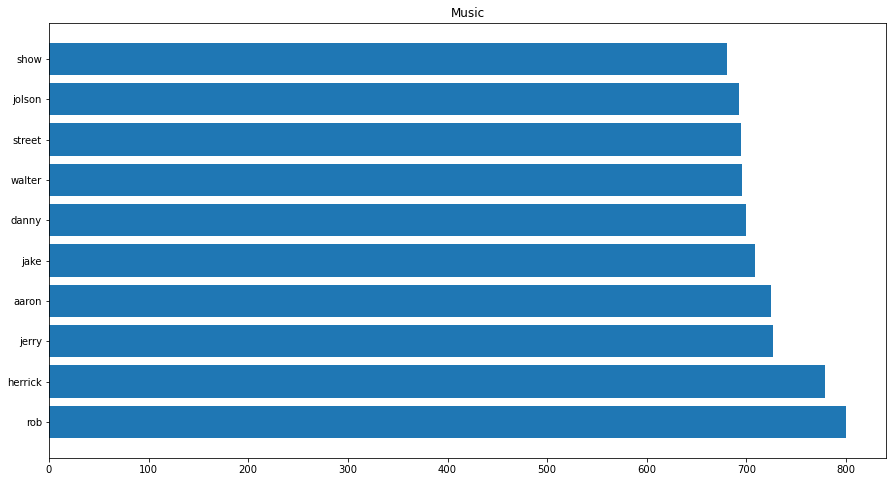

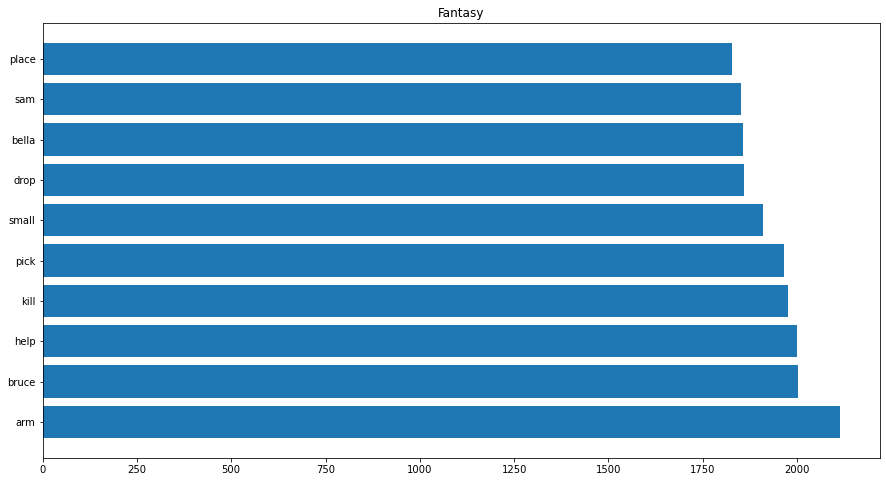

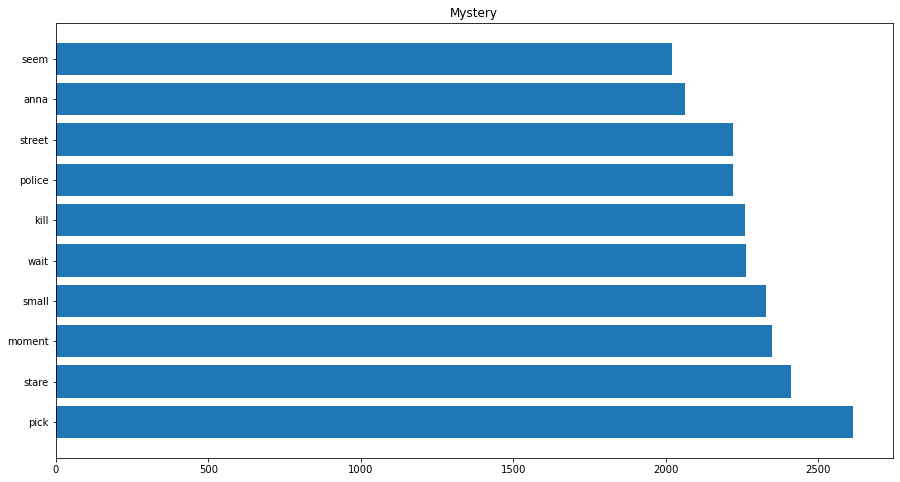

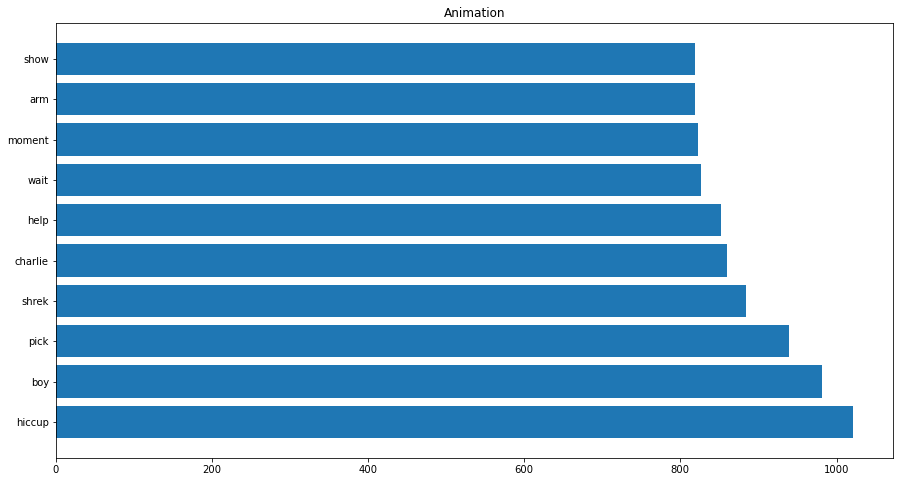

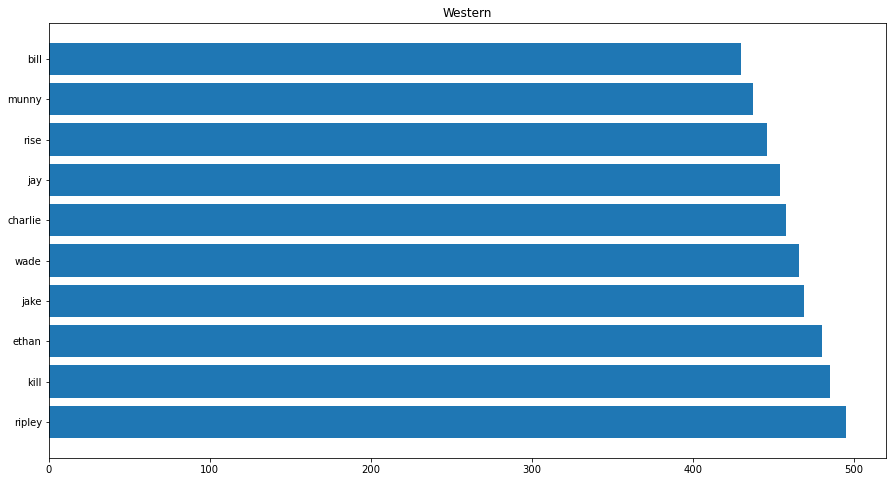

...

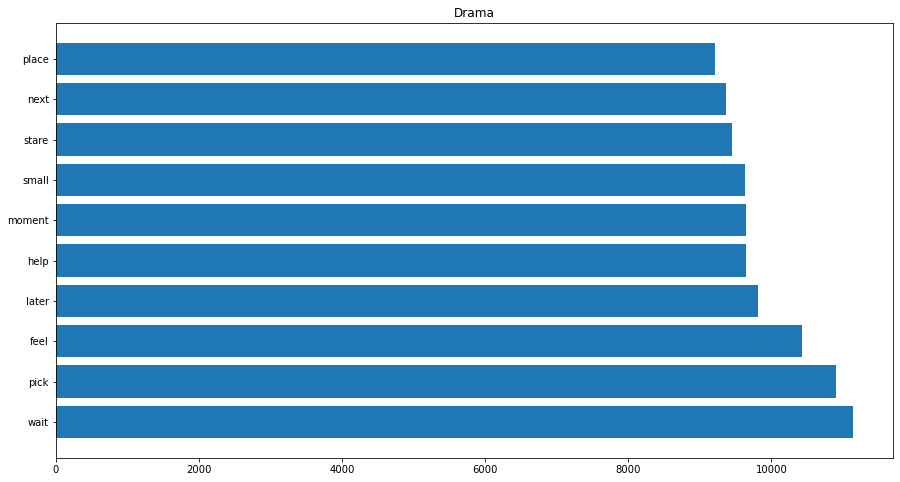

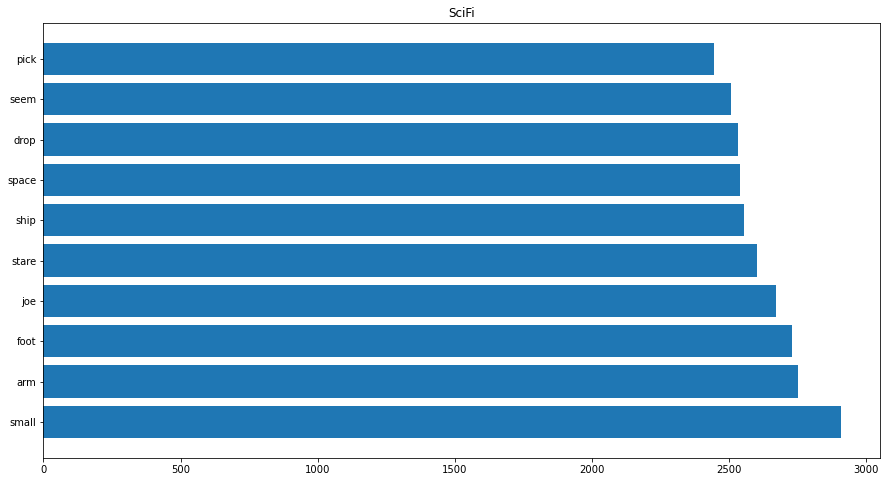

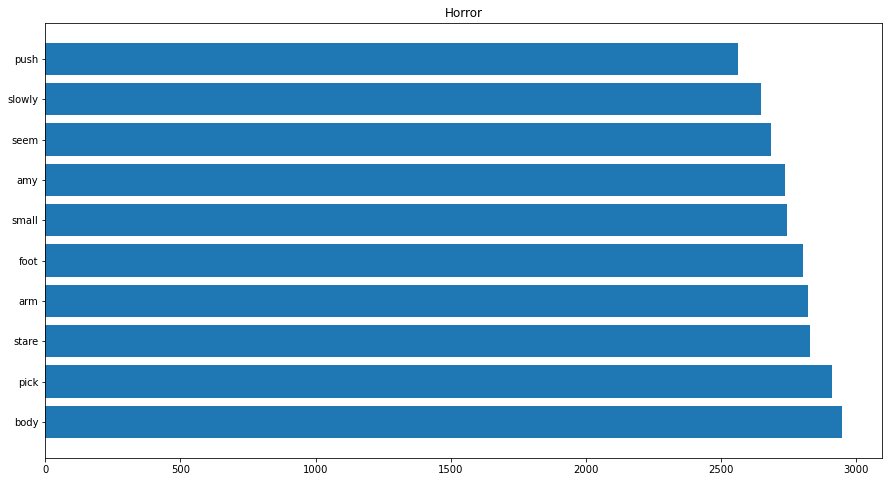

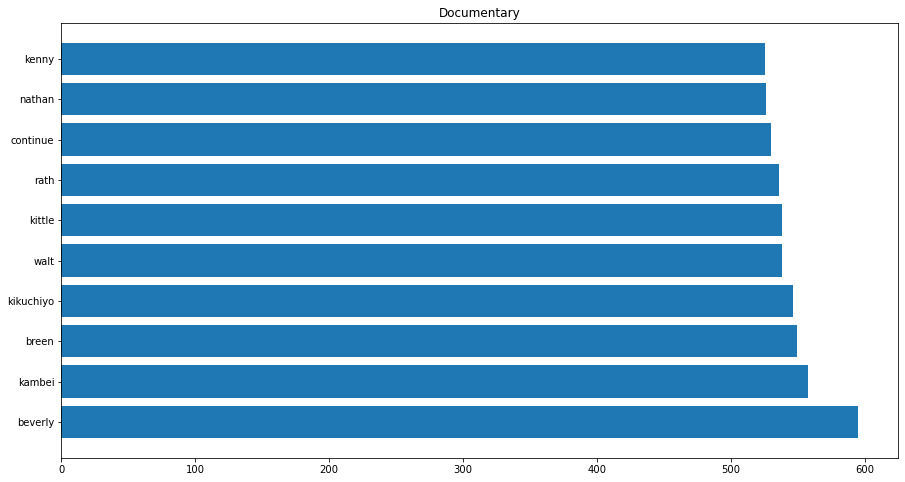

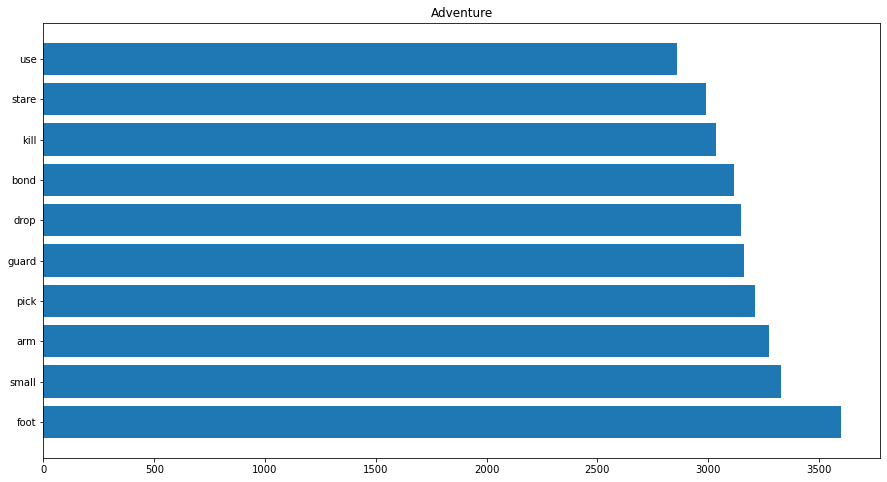

In [173]:
for i in corpuses_new.keys():
    
    fig, ax = plt.subplots(figsize=(15,8))

    ax.barh(list(range(len(top_ten_new['words {}'.format(i)]))), top_ten_new['counts {}'.format(i)])

    ax.set_yticks(list(range(len(top_ten_new['words {}'.format(i)]))))
    ax.set_yticklabels(top_ten_new['words {}'.format(i)])

    ax.set_title('{}'.format(i))

    plt.show()

In [ ]:
import itertools

stops_new = []

for i in corpuses_new.keys():

    stops_new = itertools.chain(stops, top_ten['words {}'.format(i)])



stops = list(set(stops))